# **Module 5 Project - U.S. Wildfire Prediction**

* Student name: **Alex Husted**
* Student pace: **Online Full Time - April Cohort**
* Scheduled project review date/time: **September 20th, 2019**
* Instructor name: **Rafael Carrasco**
* Blog post URL: **Work in Progress**

# **Project Overview**

This notebook represents the final project in Module 5 of Flatiron's Data Science Bootcamp. Within this project contains a database of wildfires that occurred in the United States from 1992 to 2015. It's the third update of a publication originally generated to support the national Fire Program Analysis (FPA) system. The wildfire records were acquired from the reporting systems of federal, state, and local fire organizations. The following core data elements were required for records to be included in this data publication: discovery date, final fire size, and a point location. The resulting product, referred to as the Fire Program Analysis fire-occurrence database (FPA-FOD), includes 1.88 million geo-referenced wildfire records, representing a total of 140 million acres burned during the 24-year period.

While living in Los Angeles the previous two years, I experienced two of the most horrific wildfires in U.S. history. Thankfully I was safe from harm, however, many residents in Southern California were not. Thousands lost their homes and loved ones. This experience prompted me to analyze current wildfire data within the United States and to ask the following questions:


* Given the timing and location, can a machine learning algorithm predict the next cause and size of a wildfire?
* Which regions within the U.S. are the most and least fire-prone?
* Have wildfires become more or less frequent within this 24 year period?
* Have wildfires grown in regards to intensity and size?

## Framework

This project will follow a certain methodology, named OSEMiN, to build a best-fit model. OSEMiN suggests to follow certain relational steps to help us understand the data and build our model. These steps are listed below:

**Project Method (OSEMiN)**
* Obtain and load the dataset
* Scrub and clean the data
* Explore and understand the data value
* Model the data through testing processes
* Interpret the results and conclude

## Fire Program Analysis

The purpose of the Fire Program Analysis (FPA) system is to provide managers a common, interagency process for strategic fire management planning and budgeting. Data products and efforts derived from the FPA efforts were used in the National Strategy, such as the Wildfire Potential and Burn Probability data products, among others. The U.S. federal government’s planned response to the growing threat of nation wildfires was to launch this sophisticated new computer system, the FPA, that would enable firefighting agencies to coordinate their efforts and maximize their resources.

## About Wildfires

A wildfire is an uncontrolled fire occurring in wild, unpopulated areas, with the potential to spread into urban regions harming private homes, local agriculture, humans, and animals. Unfortunately, 90% of all wildfires are started by humans. Firefighters categorize wildfires into names such as surface fires, crown fires, spot fires, and ground fires. “Crown fires” are considered the most dangerous to civilization because they burn extremely hot, travel rapidly, and can change direction quickly from winds moving across the landscape. Weather conditions play a large role in the occurrence of wildfires through extended dry spells or drought in arid regions. Within these arid regions, the accumulation of dead matter (leaves, twigs, and trees) can create enough heat in some instances to spontaneously ignite the surrounding area. In an extreme case, rolling flames travel up to 14 miles an hour, which converts to about a four-minute mile pace, and can overtake the average human in minutes. 

According to National Geographic, destruction caused by wildfires in the United States has significantly increased in the last two decades. An average of 72,400 wildfires cleared an average of 7 million acres of U.S. land each year since 2000, double the number of acres scorched by wildfires in the 1990s. In 2015, the largest wildfire season recorded in U.S. history, wildfires burned more than 10 million acres of land. We shall see if the data collected by the Fire Program Analysis (FPA) broadcasts the same message.

## SQLAlchemy

The data for this project is stored within a SQLite database. For this project, I will be using SQLAlchemy to parse through the dataset. SQLAlchemy provides a “Pythonic” way of interacting with a database. Rather than dealing with the differences between specific dialects of MySQL or SQLite, you can leverage Python framework of SQLAlchemy to streamline your workflow and more efficiently query data. SQLAlchemy can be used to automatically load tables from a database using something called reflection. Reflection is the process of reading the database and building the metadata based on that information. Overall, it provides a full suite of well known enterprise-level persistence patterns, designed for efficient and high-performing database access, adapted into a simple and Pythonic language. 

# **Project Prework**

Before moving forward with visual exploration, there are necessary steps to become familiar with the FPA dataset. First, importing libraries needed to complete an analysis of the data would be helpful. Then, it's important to examine the moving parts within the dataset. What is stored within the database? How are the items categorized? How many tables contain relevant information? Questions like these will help develop a better understanding of the dataset and eventually will guide effective visual and data exploration.

## Import Libraries

In [53]:
# Import SQLite3
import sqlite3

# Import Pandas
import pandas as pd

# Import Numpy
import numpy as np

# Import Visuals
import matplotlib.pyplot as plt 
from matplotlib.dates import DateFormatter
%matplotlib inline
from mpl_toolkits.basemap import Basemap, cm
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
from jupyterthemes import jtplot
jtplot.style(theme='onedork')
from matplotlib import animation

# Import SkLearn
from sklearn import tree, preprocessing
import sklearn.ensemble as ske
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import confusion_matrix
import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

#Import os
import os

# Import SQL Alchemy
import sqlalchemy
from sqlalchemy import create_engine 
from sqlalchemy.orm import Session, sessionmaker
from sqlalchemy import inspect

## Load Dataset

In [55]:
# Create a session for ORM
engine = create_engine('sqlite:///data/FPA_FOD_20170508.sqlite', echo = True)
Session = sessionmaker(bind=engine)
session = Session()
inspector = inspect(engine)

2019-09-19 12:20:07,713 INFO sqlalchemy.engine.base.Engine SELECT CAST('test plain returns' AS VARCHAR(60)) AS anon_1


INFO:sqlalchemy.engine.base.Engine:SELECT CAST('test plain returns' AS VARCHAR(60)) AS anon_1


2019-09-19 12:20:07,714 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


2019-09-19 12:20:07,718 INFO sqlalchemy.engine.base.Engine SELECT CAST('test unicode returns' AS VARCHAR(60)) AS anon_1


INFO:sqlalchemy.engine.base.Engine:SELECT CAST('test unicode returns' AS VARCHAR(60)) AS anon_1


2019-09-19 12:20:07,720 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


## Table Information

In [18]:
# Print the table names
print(inspector.get_table_names())
print(len((inspector.get_table_names())))

2019-09-17 20:07:01,400 INFO sqlalchemy.engine.base.Engine SELECT name FROM sqlite_master WHERE type='table' ORDER BY name


INFO:sqlalchemy.engine.base.Engine:SELECT name FROM sqlite_master WHERE type='table' ORDER BY name


2019-09-17 20:07:01,402 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


['ElementaryGeometries', 'Fires', 'KNN', 'NWCG_UnitIDActive_20170109', 'SpatialIndex', 'geometry_columns', 'geometry_columns_auth', 'geometry_columns_field_infos', 'geometry_columns_statistics', 'geometry_columns_time', 'idx_Fires_Shape', 'idx_Fires_Shape_node', 'idx_Fires_Shape_parent', 'idx_Fires_Shape_rowid', 'spatial_ref_sys', 'spatial_ref_sys_aux', 'spatialite_history', 'sql_statements_log', 'sqlite_sequence', 'views_geometry_columns', 'views_geometry_columns_auth', 'views_geometry_columns_field_infos', 'views_geometry_columns_statistics', 'virts_geometry_columns', 'virts_geometry_columns_auth', 'virts_geometry_columns_field_infos', 'virts_geometry_columns_statistics']
27


There are 27 table names:

    * 'ElementaryGeometries'
    * 'Fires'
    * 'KNN'
    * 'NWCG_UnitIDActive_20170109'
    * 'SpatialIndex'
    * 'geometry_columns'
    * 'geometry_columns_auth'
    * 'geometry_columns_field_infos'
    * 'geometry_columns_statistics'
    * 'geometry_columns_time'
    * 'idx_Fires_Shape'
    * 'idx_Fires_Shape_node'
    * 'idx_Fires_Shape_parent'
    * 'idx_Fires_Shape_rowid' 
    * 'spatial_ref_sys'
    * 'spatial_ref_sys_aux'
    * 'spatialite_history'
    * 'sql_statements_log'
    * 'sqlite_sequence'
    * 'views_geometry_columns'
    * 'views_geometry_columns_auth'
    * 'views_geometry_columns_field_infos'
    * 'views_geometry_columns_statistics'
    * 'virts_geometry_columns'
    * 'virts_geometry_columns_auth'
    * 'virts_geometry_columns_field_infos'
    * 'virts_geometry_columns_statistics'

In [19]:
# Write a function to analyze tables
def get_columns_info(col_name):
    cols_list = inspector.get_columns(col_name)
    
    print("Table Name: {}".format(col_name))
    print("")
    
    for column in cols_list:
        print("Name: {} \t Type: {}".format(column['name'], column['type']))

get_columns_info('Fires')

2019-09-17 20:07:03,629 INFO sqlalchemy.engine.base.Engine PRAGMA table_info("Fires")


INFO:sqlalchemy.engine.base.Engine:PRAGMA table_info("Fires")


2019-09-17 20:07:03,630 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


Table Name: Fires

Name: OBJECTID 	 Type: INTEGER
Name: FOD_ID 	 Type: INTEGER
Name: FPA_ID 	 Type: TEXT(100)
Name: SOURCE_SYSTEM_TYPE 	 Type: TEXT(255)
Name: SOURCE_SYSTEM 	 Type: TEXT(30)
Name: NWCG_REPORTING_AGENCY 	 Type: TEXT(255)
Name: NWCG_REPORTING_UNIT_ID 	 Type: TEXT(255)
Name: NWCG_REPORTING_UNIT_NAME 	 Type: TEXT(255)
Name: SOURCE_REPORTING_UNIT 	 Type: TEXT(30)
Name: SOURCE_REPORTING_UNIT_NAME 	 Type: TEXT(255)
Name: LOCAL_FIRE_REPORT_ID 	 Type: TEXT(255)
Name: LOCAL_INCIDENT_ID 	 Type: TEXT(255)
Name: FIRE_CODE 	 Type: TEXT(10)
Name: FIRE_NAME 	 Type: TEXT(255)
Name: ICS_209_INCIDENT_NUMBER 	 Type: TEXT(255)
Name: ICS_209_NAME 	 Type: TEXT(255)
Name: MTBS_ID 	 Type: TEXT(255)
Name: MTBS_FIRE_NAME 	 Type: TEXT(50)
Name: COMPLEX_NAME 	 Type: TEXT(255)
Name: FIRE_YEAR 	 Type: INTEGER
Name: DISCOVERY_DATE 	 Type: REAL
Name: DISCOVERY_DOY 	 Type: INTEGER
Name: DISCOVERY_TIME 	 Type: TEXT(4)
Name: STAT_CAUSE_CODE 	 Type: REAL
Name: STAT_CAUSE_DESCR 	 Type: TEXT(100)
Name: CONT_

This dataset is an SQLite database that contains the following information:

Fires: Table including wildfire data for the period of 1992-2015 compiled from US federal, state, and local reporting systems.

    * FOD_ID = Global unique identifier.
    * FPA_ID = Unique identifier that contains information necessary to track back to the original record in the source dataset.
    * SOURCE_SYSTEM_TYPE = Type of source database or system that the record was drawn from (federal, nonfederal, or interagency).
    * SOURCE_SYSTEM = Name of or other identifier for source database or system that the record was drawn from. See Table 1 in Short (2014), or \Supplements\FPA_FOD_source_list.pdf, for a list of sources and their identifier.
    * NWCG_REPORTING_AGENCY = Active National Wildlife Coordinating Group (NWCG) Unit Identifier for the agency preparing the fire report (BIA = Bureau of Indian Affairs, BLM = Bureau of Land Management, BOR = Bureau of Reclamation, DOD = Department of Defense, DOE = Department of Energy, FS = Forest Service, FWS = Fish and Wildlife Service, IA = Interagency Organization, NPS = National Park Service, ST/C&L = State, County, or Local Organization, and TRIBE = Tribal Organization).
    * NWCG_REPORTING_UNIT_ID = Active NWCG Unit Identifier for the unit preparing the fire report.
    * NWCG_REPORTING_UNIT_NAME = Active NWCG Unit Name for the unit preparing the fire report.
    * SOURCE_REPORTING_UNIT = Code for the agency unit preparing the fire report, based on code/name in the source dataset.
    * SOURCE_REPORTING_UNIT_NAME = Name of reporting agency unit preparing the fire report, based on code/name in the source dataset.
    * LOCAL_FIRE_REPORT_ID = Number or code that uniquely identifies an incident report for a particular reporting unit and a particular calendar year.
    * LOCAL_INCIDENT_ID = Number or code that uniquely identifies an incident for a particular local fire management organization within a particular calendar year.
    * FIRE_CODE = Code used within the interagency wildland fire community to track and compile cost information for emergency fire suppression (https://www.firecode.gov/).
    * FIRE_NAME = Name of the incident, from the fire report (primary) or ICS-209 report (secondary).
    * ICS_209_INCIDENT_NUMBER = Incident (event) identifier, from the ICS-209 report.
    * ICS_209_NAME = Name of the incident, from the ICS-209 report.
    * MTBS_ID = Incident identifier, from the MTBS perimeter dataset.
    * MTBS_FIRE_NAME = Name of the incident, from the MTBS perimeter dataset.
    * COMPLEX_NAME = Name of the complex under which the fire was ultimately managed, when discernible.
    * FIRE_YEAR = Calendar year in which the fire was discovered or confirmed to exist.
    * DISCOVERY_DATE = Date on which the fire was discovered or confirmed to exist.
    * DISCOVERY_DOY = Day of year on which the fire was discovered or confirmed to exist.
    * DISCOVERY_TIME = Time of day that the fire was discovered or confirmed to exist.
    * STAT_CAUSE_CODE = Code for the (statistical) cause of the fire.
    * STAT_CAUSE_DESCR = Description of the (statistical) cause of the fire.
    * CONT_DATE = Date on which the fire was declared contained or otherwise controlled (mm/dd/yyyy where mm=month, dd=day, and yyyy=year).
    * CONT_DOY = Day of year on which the fire was declared contained or otherwise controlled.
    * CONT_TIME = Time of day that the fire was declared contained or otherwise controlled (hhmm where hh=hour, mm=minutes).
    * FIRE_SIZE = Estimate of acres within the final perimeter of the fire.
    * FIRE_SIZE_CLASS = Code for fire size based on the number of acres within the final fire perimeter expenditures (A=greater than 0 but less than or equal to 0.25 acres, B=0.26-9.9 acres, C=10.0-99.9 acres, D=100-299 acres, E=300 to 999 acres, F=1000 to 4999 acres, and G=5000+ acres).
    * LATITUDE = Latitude (NAD83) for point location of the fire (decimal degrees).
    * LONGITUDE = Longitude (NAD83) for point location of the fire (decimal degrees).
    * OWNER_CODE = Code for primary owner or entity responsible for managing the land at the point of origin of the fire at the time of the incident.
    * OWNER_DESCR = Name of primary owner or entity responsible for managing the land at the point of origin of the fire at the time of the incident.
    * STATE = Two-letter alphabetic code for the state in which the fire burned (or originated), based on the nominal designation in the fire report.
    * COUNTY = County, or equivalent, in which the fire burned (or originated), based on nominal designation in the fire report.
    * FIPS_CODE = Three-digit code from the Federal Information Process Standards (FIPS) publication 6-4 for representation of counties and equivalent entities.
    * FIPS_NAME = County name from the FIPS publication 6-4 for representation of counties and equivalent entities.
    * NWCG_UnitIDActive_20170109: Look-up table containing all NWCG identifiers for agency units that were active (i.e., valid) as of 9 January 2017 and used as the source of values available to populate the following fields in the Fires table: NWCG_REPORTING_AGENCY, NWCG_REPORTING_UNIT_ID, and NWCG_REPORTING_UNIT_NAME.
    * UnitId = NWCG Unit ID.
    * GeographicArea = Two-letter code for the geographic area in which the unit is located (NA=National, IN=International, AK=Alaska, CA=California, EA=Eastern Area, GB=Great Basin, NR=Northern Rockies, NW=Northwest, RM=Rocky Mountain, SA=Southern Area, and SW=Southwest).
    * Gacc = Seven or eight-letter code for the Geographic Area Coordination Center in which the unit is located or primarily affiliated with (CAMBCIFC=Canadian Interagency Forest Fire Centre, USAKCC=Alaska Interagency Coordination Center, USCAONCC=Northern California Area Coordination Center, USCAOSCC=Southern California Coordination Center, USCORMCC=Rocky Mountain Area Coordination Center, USGASAC=Southern Area Coordination Center, USIDNIC=National Interagency Coordination Center, USMTNRC=Northern Rockies Coordination Center, USNMSWC=Southwest Area Coordination Center, USORNWC=Northwest Area Coordination Center, USUTGBC=Western Great Basin Coordination Center, USWIEACC=Eastern Area Coordination Center).
    * WildlandRole = Role of the unit within the wildland fire community.
    * UnitType = Type of unit (e.g., federal, state, local).
    * Department = Department (or state/territory) to which the unit belongs (AK=Alaska, AL=Alabama, AR=Arkansas, AZ=Arizona, CA=California, CO=Colorado, CT=Connecticut, DE=Delaware, DHS=Department of Homeland Security, DOC= Department of Commerce, DOD=Department of Defense, DOE=Department of Energy, DOI= Department of Interior, DOL=Department of Labor, FL=Florida, GA=Georgia, IA=Iowa, IA/GC=Non-Departmental Agencies, ID=Idaho, IL=Illinois, IN=Indiana, KS=Kansas, KY=Kentucky, LA=Louisiana, MA=Massachusetts, MD=Maryland, ME=Maine, MI=Michigan, MN=Minnesota, MO=Missouri, MS=Mississippi, MT=Montana, NC=North Carolina, NE=Nebraska, NG=Non-Government, NH=New Hampshire, NJ=New Jersey, NM=New Mexico, NV=Nevada, NY=New York, OH=Ohio, OK=Oklahoma, OR=Oregon, PA=Pennsylvania, PR=Puerto Rico, RI=Rhode Island, SC=South Carolina, SD=South Dakota, ST/L=State or Local Government, TN=Tennessee, Tribe=Tribe, TX=Texas, USDA=Department of Agriculture, UT=Utah, VA=Virginia, VI=U. S. Virgin Islands, VT=Vermont, WA=Washington, WI=Wisconsin, WV=West Virginia, WY=Wyoming).
    * Agency = Agency or bureau to which the unit belongs (AG=Air Guard, ANC=Alaska Native Corporation, BIA=Bureau of Indian Affairs, BLM=Bureau of Land Management, BOEM=Bureau of Ocean Energy Management, BOR=Bureau of Reclamation, BSEE=Bureau of Safety and Environmental Enforcement, C&L=County & Local, CDF=California Department of Forestry & Fire Protection, DC=Department of Corrections, DFE=Division of Forest Environment, DFF=Division of Forestry Fire & State Lands, DFL=Division of Forests and Land, DFR=Division of Forest Resources, DL=Department of Lands, DNR=Department of Natural Resources, DNRC=Department of Natural Resources and Conservation, DNRF=Department of Natural Resources Forest Service, DOA=Department of Agriculture, DOC=Department of Conservation, DOE=Department of Energy, DOF=Department of Forestry, DVF=Division of Forestry, DWF=Division of Wildland Fire, EPA=Environmental Protection Agency, FC=Forestry Commission, FEMA=Federal Emergency Management Agency, FFC=Bureau of Forest Fire Control, FFP=Forest Fire Protection, FFS=Forest Fire Service, FR=Forest Rangers, FS=Forest Service, FWS=Fish & Wildlife Service, HQ=Headquarters, JC=Job Corps, NBC=National Business Center, NG=National Guard, NNSA=National Nuclear Security Administration, NPS=National Park Service, NWS=National Weather Service, OES=Office of Emergency Services, PRI=Private, SF=State Forestry, SFS=State Forest Service, SP=State Parks, TNC=The Nature Conservancy, USA=United States Army, USACE=United States Army Corps of Engineers, USAF=United States Air Force, USGS=United States Geological Survey, USN=United States Navy).
    * Parent = Agency subgroup to which the unit belongs (A concatenation of State and Unit from this report - https://www.nifc.blm.gov/unit_id/publish/UnitIdReport.rtf).
    * Country = Country in which the unit is located (e.g. US = United States).
    * State = Two-letter code for the state in which the unit is located (or primarily affiliated).
    * Code = Unit code (follows state code to create UnitId).
    * Name = Unit name.

In [20]:
# Get geometry_columns table information
get_columns_info('geometry_columns')

2019-09-17 20:07:05,295 INFO sqlalchemy.engine.base.Engine PRAGMA table_info("geometry_columns")


INFO:sqlalchemy.engine.base.Engine:PRAGMA table_info("geometry_columns")


2019-09-17 20:07:05,297 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


Table Name: geometry_columns

Name: f_table_name 	 Type: TEXT
Name: f_geometry_column 	 Type: TEXT
Name: geometry_type 	 Type: INTEGER
Name: coord_dimension 	 Type: INTEGER
Name: srid 	 Type: INTEGER
Name: spatial_index_enabled 	 Type: INTEGER


Above there is information about the key-value pairs of each table queried. Note the data types are mainly TEXT, INTEGERs and REAL. These tables can store significant amounts of information and therefore it's important to identify where the information is located. In the following exploration, there will likely be a visualizations pertaining to the amount of fires occurring within given years. Information on fires can be found in the 'Fires' table. 

## Fire Table

In [21]:
# Establish a connection
con = engine.connect()
emp = con.execute("SELECT * FROM Fires LIMIT 5")
print(emp.fetchall())

2019-09-17 20:07:07,393 INFO sqlalchemy.engine.base.Engine SELECT * FROM Fires LIMIT 5


INFO:sqlalchemy.engine.base.Engine:SELECT * FROM Fires LIMIT 5


2019-09-17 20:07:07,394 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


[(1, 1, 'FS-1418826', 'FED', 'FS-FIRESTAT', 'FS', 'USCAPNF', 'Plumas National Forest', '0511', 'Plumas National Forest', '1', 'PNF-47', 'BJ8K', 'FOUNTAIN', None, None, None, None, None, 2005, 2453403.5, 33, '1300', 9.0, 'Miscellaneous', 2453403.5, 33, '1730', 0.1, 'A', 40.03694444, -121.00583333, 5.0, 'USFS', 'CA', '63', '063', 'Plumas', b'\x00\x01\xad\x10\x00\x00\xe8d\xc2\x92_@^\xc0\xe0\xc8l\x98\xba\x04D@\xe8d\xc2\x92_@^\xc0\xe0\xc8l\x98\xba\x04D@|\x01\x00\x00\x00\xe8d\xc2\x92_@^\xc0\xe0\xc8l\x98\xba\x04D@\xfe'), (2, 2, 'FS-1418827', 'FED', 'FS-FIRESTAT', 'FS', 'USCAENF', 'Eldorado National Forest', '0503', 'Eldorado National Forest', '13', '13', 'AAC0', 'PIGEON', None, None, None, None, None, 2004, 2453137.5, 133, '0845', 1.0, 'Lightning', 2453137.5, 133, '1530', 0.25, 'A', 38.93305556, -120.40444444, 5.0, 'USFS', 'CA', '61', '061', 'Placer', b'\x00\x01\xad\x10\x00\x00T\xb6\xeej\xe2\x19^\xc0\x90\xc6U]nwC@T\xb6\xeej\xe2\x19^\xc0\x90\xc6U]nwC@|\x01\x00\x00\x00T\xb6\xeej\xe2\x19^\xc0\x9

In [22]:
# Create a dataframe for Fires
rs = con.execute('''SELECT * 
                 FROM Fires''')
df = pd.DataFrame(rs.fetchall())

2019-09-17 20:07:08,164 INFO sqlalchemy.engine.base.Engine SELECT * 
                 FROM Fires


INFO:sqlalchemy.engine.base.Engine:SELECT * 
                 FROM Fires


2019-09-17 20:07:08,166 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


In [56]:
# Retrieve a dataframe of Fire information
fire_df = pd.read_sql_query('''SELECT * 
                       FROM Fires''', engine)
# df.Id.value_counts()
fire_df.head()

2019-09-19 12:20:21,581 INFO sqlalchemy.engine.base.Engine SELECT * 
                       FROM Fires


INFO:sqlalchemy.engine.base.Engine:SELECT * 
                       FROM Fires


2019-09-19 12:20:21,583 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


,OBJECTID,FOD_ID,FPA_ID,SOURCE_SYSTEM_TYPE,SOURCE_SYSTEM,NWCG_REPORTING_AGENCY,NWCG_REPORTING_UNIT_ID,NWCG_REPORTING_UNIT_NAME,SOURCE_REPORTING_UNIT,SOURCE_REPORTING_UNIT_NAME,...,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,OWNER_CODE,OWNER_DESCR,STATE,COUNTY,FIPS_CODE,FIPS_NAME,Shape
0,1,1,FS-1418826,FED,FS-FIRESTAT,FS,USCAPNF,Plumas National Forest,0511,Plumas National Forest,...,A,40.036944,-121.005833,5.0,USFS,CA,63,063,Plumas,b'\x00\x01\xad\x10\x00\x00\xe8d\xc2\x92_@^\xc0...
1,2,2,FS-1418827,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,...,A,38.933056,-120.404444,5.0,USFS,CA,61,061,Placer,b'\x00\x01\xad\x10\x00\x00T\xb6\xeej\xe2\x19^\...
2,3,3,FS-1418835,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,...,A,38.984167,-120.735556,13.0,STATE OR PRIVATE,CA,17,017,El Dorado,b'\x00\x01\xad\x10\x00\x00\xd0\xa5\xa0W\x13/^\...
3,4,4,FS-1418845,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,...,A,38.559167,-119.913333,5.0,USFS,CA,3,003,Alpine,b'\x00\x01\xad\x10\x00\x00\x94\xac\xa3\rt\xfa]...
4,5,5,FS-1418847,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,...,A,38.559167,-119.933056,5.0,USFS,CA,3,003,Alpine,b'\x00\x01\xad\x10\x00\x00@\xe3\xaa.\xb7\xfb]\...


In [82]:
# Retrieve a dataframe of Important Fire information
fire_dash_df = pd.read_sql_query('''SELECT  
                                   SOURCE_REPORTING_UNIT, SOURCE_REPORTING_UNIT_NAME, LOCAL_FIRE_REPORT_ID,
                                   FIRE_NAME, FIRE_YEAR, DISCOVERY_DATE, DISCOVERY_DOY, DISCOVERY_TIME, 
                                   STAT_CAUSE_CODE, STAT_CAUSE_DESCR, CONT_DATE, CONT_DOY, CONT_TIME, 
                                   FIRE_SIZE, FIRE_SIZE_CLASS, LATITUDE, LONGITUDE, STATE, COUNTY
                                   FROM Fires''', engine)
fire_dash_df.head()

2019-09-19 13:43:27,342 INFO sqlalchemy.engine.base.Engine SELECT  
                                   SOURCE_REPORTING_UNIT, SOURCE_REPORTING_UNIT_NAME, LOCAL_FIRE_REPORT_ID,
                                   FIRE_NAME, FIRE_YEAR, DISCOVERY_DATE, DISCOVERY_DOY, DISCOVERY_TIME, 
                                   STAT_CAUSE_CODE, STAT_CAUSE_DESCR, CONT_DATE, CONT_DOY, CONT_TIME, 
                                   FIRE_SIZE, FIRE_SIZE_CLASS, LATITUDE, LONGITUDE, STATE, COUNTY
                                   FROM Fires


INFO:sqlalchemy.engine.base.Engine:SELECT  
                                   SOURCE_REPORTING_UNIT, SOURCE_REPORTING_UNIT_NAME, LOCAL_FIRE_REPORT_ID,
                                   FIRE_NAME, FIRE_YEAR, DISCOVERY_DATE, DISCOVERY_DOY, DISCOVERY_TIME, 
                                   STAT_CAUSE_CODE, STAT_CAUSE_DESCR, CONT_DATE, CONT_DOY, CONT_TIME, 
                                   FIRE_SIZE, FIRE_SIZE_CLASS, LATITUDE, LONGITUDE, STATE, COUNTY
                                   FROM Fires


2019-09-19 13:43:27,344 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


,SOURCE_REPORTING_UNIT,SOURCE_REPORTING_UNIT_NAME,LOCAL_FIRE_REPORT_ID,FIRE_NAME,FIRE_YEAR,DISCOVERY_DATE,DISCOVERY_DOY,DISCOVERY_TIME,STAT_CAUSE_CODE,STAT_CAUSE_DESCR,CONT_DATE,CONT_DOY,CONT_TIME,FIRE_SIZE,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,STATE,COUNTY
0,0511,Plumas National Forest,1,FOUNTAIN,2005,2453403.5,33,1300,9.0,Miscellaneous,2453403.5,33.0,1730,0.10,A,40.036944,-121.005833,CA,63
1,0503,Eldorado National Forest,13,PIGEON,2004,2453137.5,133,0845,1.0,Lightning,2453137.5,133.0,1530,0.25,A,38.933056,-120.404444,CA,61
2,0503,Eldorado National Forest,27,SLACK,2004,2453156.5,152,1921,5.0,Debris Burning,2453156.5,152.0,2024,0.10,A,38.984167,-120.735556,CA,17
3,0503,Eldorado National Forest,43,DEER,2004,2453184.5,180,1600,1.0,Lightning,2453189.5,185.0,1400,0.10,A,38.559167,-119.913333,CA,3
4,0503,Eldorado National Forest,44,STEVENOT,2004,2453184.5,180,1600,1.0,Lightning,2453189.5,185.0,1200,0.10,A,38.559167,-119.933056,CA,3


In [83]:
fire_dash_df.to_csv('fire_dash_df.csv')

In [24]:
# Print the column names for fire_df
print(fire_df.columns)
print(len(fire_df.columns))

Index(['OBJECTID', 'FOD_ID', 'FPA_ID', 'SOURCE_SYSTEM_TYPE', 'SOURCE_SYSTEM',
       'NWCG_REPORTING_AGENCY', 'NWCG_REPORTING_UNIT_ID',
       'NWCG_REPORTING_UNIT_NAME', 'SOURCE_REPORTING_UNIT',
       'SOURCE_REPORTING_UNIT_NAME', 'LOCAL_FIRE_REPORT_ID',
       'LOCAL_INCIDENT_ID', 'FIRE_CODE', 'FIRE_NAME',
       'ICS_209_INCIDENT_NUMBER', 'ICS_209_NAME', 'MTBS_ID', 'MTBS_FIRE_NAME',
       'COMPLEX_NAME', 'FIRE_YEAR', 'DISCOVERY_DATE', 'DISCOVERY_DOY',
       'DISCOVERY_TIME', 'STAT_CAUSE_CODE', 'STAT_CAUSE_DESCR', 'CONT_DATE',
       'CONT_DOY', 'CONT_TIME', 'FIRE_SIZE', 'FIRE_SIZE_CLASS', 'LATITUDE',
       'LONGITUDE', 'OWNER_CODE', 'OWNER_DESCR', 'STATE', 'COUNTY',
       'FIPS_CODE', 'FIPS_NAME', 'Shape'],
      dtype='object')
39


In [50]:
# Write a SQL query to retrieve information of the largest fires in the dataset
fire_info = pd.read_sql_query("""
                        SELECT FIRE_NAME, FIRE_YEAR, STATE, FIRE_SIZE_CLASS, FIRE_SIZE
                        FROM Fires
                        WHERE STATE IS NOT 'AK'
                        ORDER BY FIRE_SIZE DESC
                        LIMIT 1000
                        """, engine)
fire_info

2019-09-17 22:23:12,300 INFO sqlalchemy.engine.base.Engine 
                        SELECT FIRE_NAME, FIRE_YEAR, STATE, FIRE_SIZE_CLASS, FIRE_SIZE
                        FROM Fires
                        WHERE STATE IS NOT 'AK'
                        ORDER BY FIRE_SIZE DESC
                        LIMIT 1000
                        


INFO:sqlalchemy.engine.base.Engine:
                        SELECT FIRE_NAME, FIRE_YEAR, STATE, FIRE_SIZE_CLASS, FIRE_SIZE
                        FROM Fires
                        WHERE STATE IS NOT 'AK'
                        ORDER BY FIRE_SIZE DESC
                        LIMIT 1000
                        


2019-09-17 22:23:12,301 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


,FIRE_NAME,FIRE_YEAR,STATE,FIRE_SIZE_CLASS,FIRE_SIZE
0,LONG DRAW,2012,OR,G,558198.3
1,WALLOW,2011,AZ,G,538049.0
2,BISCUIT,2002,OR,G,499945.0
3,HWY 152,2006,TX,G,479549.0
4,HOLLOWAY,2012,OR,G,461047.0
5,I-40,2006,TX,G,427696.0
6,MURPHY COMPLEX,2007,ID,G,367785.0
7,MILFORD FLAT,2007,UT,G,357185.0
8,RUSH,2012,CA,G,315578.8
9,ROCKHOUSE FIRE,2011,TX,G,314444.0


In [51]:
fire_info.STATE.value_counts()

ID    151
CA    143
NV    116
OR     98
MT     71
NM     69
TX     68
WA     56
UT     45
AZ     45
FL     33
WY     22
CO     16
OK     14
NE     12
SD      9
MN      8
KS      7
GA      6
NC      5
MI      2
SC      1
NJ      1
HI      1
ND      1
Name: STATE, dtype: int64

Within the 'Fires' table we can find information on 1.8 million U.S. wildfires over the course of two decades. This is the table in which will guide the exploration for our project. There are 39 columns within the table, each column representing a datapoint of one instance of a wildfire. Notably, FIRE_NAME, FIRE_YEAR, STATE, FIRE_SIZE_CLASS, FIRE_SIZE could be used within a query to identify the largest fires and location of these fires within the time span. 

# **Exploring Wildfires**

Exploratory Data Analysis, or EDA, is an integral part of understanding the FPA dataset. Before moving towards machine learning for the dataset, it's vital to become familiar with different realtionships within the data. Analyzing these relationships will provide intuition about how to interpret the results of the proceeding results. Asking questions about these relationships beforehand might also supply additional knowledge about relationships that we might have not known existed. This section will further investigate the distribution of data and demonstrate the impact of wildfires across the country. 

## Wildfire Locations

In [26]:
# Write a SQL query to identify fire locations
loc_df = pd.read_sql_query("""
                        SELECT FIRE_NAME, FIRE_YEAR, STATE, FIRE_SIZE_CLASS, FIRE_SIZE
                        FROM Fires 
                        ORDER BY FIRE_SIZE DESC
                        """, engine)
loc_df.head()

2019-09-17 20:08:56,674 INFO sqlalchemy.engine.base.Engine 
                        SELECT FIRE_NAME, FIRE_YEAR, STATE, FIRE_SIZE_CLASS, FIRE_SIZE
                        FROM Fires 
                        ORDER BY FIRE_SIZE DESC
                        


INFO:sqlalchemy.engine.base.Engine:
                        SELECT FIRE_NAME, FIRE_YEAR, STATE, FIRE_SIZE_CLASS, FIRE_SIZE
                        FROM Fires 
                        ORDER BY FIRE_SIZE DESC
                        


2019-09-17 20:08:56,676 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


,FIRE_NAME,FIRE_YEAR,STATE,FIRE_SIZE_CLASS,FIRE_SIZE
0,INOWAK,1997,AK,G,606945.0
1,LONG DRAW,2012,OR,G,558198.3
2,WALLOW,2011,AZ,G,538049.0
3,BOUNDARY,2004,AK,G,537627.0
4,MINTO FLATS SOUTH,2009,AK,G,517078.0


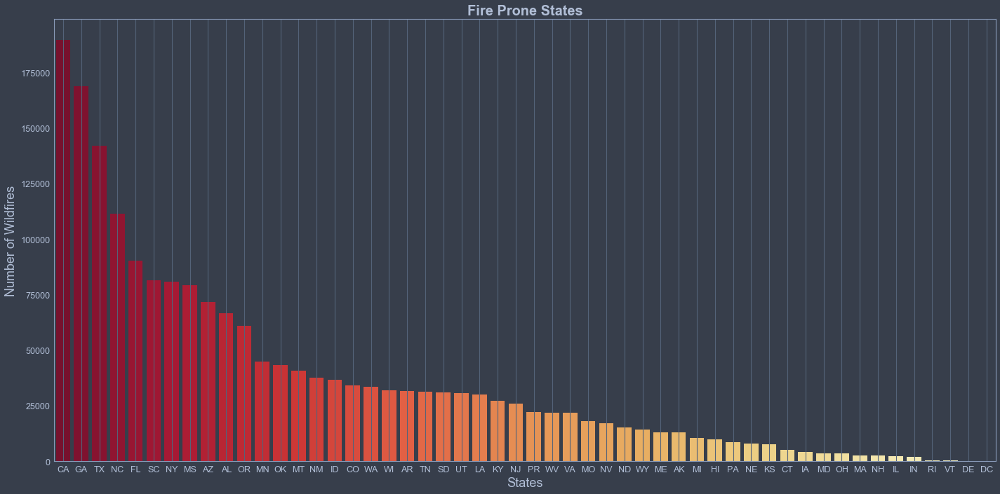

In [27]:
# Plot the most and least fire prone states in terms of number of wildfires
plt.figure(figsize = (20,10))
ax = sns.countplot(x = 'STATE' , data = loc_df, palette = 'YlOrRd_r', order = loc_df['STATE'].value_counts().index)
ax.set_ylabel('Number of Wildfires', fontdict = {'fontsize':18, 'fontweight': 'medium'})
ax.set_xlabel('States', fontdict = {'fontsize':18, 'fontweight': 'medium'})
ax.set_title('Fire Prone States', fontdict = {'fontsize':20, 'fontweight': 'bold'})
ax.grid()
plt.tight_layout()

It appears, in number of wildfires, California is leading the nation (not a good thing). Georgia, surprisingly to me, is second with almost 175,000 wildfires within the 23 year time period. Texas, North Carolina, and Florida are close behind. Looking at the top 10 most fire prone states, 6/10 are from southeastern states. Before beginning this project, I would have estimated this would have occurred in southWESTERN states. Interesting that Alaska is far down the list, as you will see, Alaska is well-known for housing some of the largest wildfires in the country. 

In [28]:
# Write a SQL query to plot the contour map
contour_df = pd.read_sql_query('''
                               SELECT LATITUDE, LONGITUDE
                               FROM Fires
                               ''', engine)

2019-09-17 20:09:14,401 INFO sqlalchemy.engine.base.Engine 
                               SELECT LATITUDE, LONGITUDE
                               FROM Fires
                               


INFO:sqlalchemy.engine.base.Engine:
                               SELECT LATITUDE, LONGITUDE
                               FROM Fires
                               


2019-09-17 20:09:14,402 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


In [29]:
# Set latitude and longitude variables
lats = contour_df['LATITUDE']
lons = contour_df['LONGITUDE']

In [30]:
# Bounding box of continental united states
bbox_ll = [24.356308, -124.848974]
bbox_ur = [49.384358, -66.885444] 

# Geographical center of united states
lat_0 = 39.833333
lon_0 = -98.583333

# Compute appropriate bins to aggregate data
# nx is number of bins in x-axis, i.e. longitude
# ny is number of bins in y-axis, i.e. latitude
nx = 80
ny = 40

# Form the bins
lon_bins = np.linspace(bbox_ll[1], bbox_ur[1], nx)
lat_bins = np.linspace(bbox_ll[0], bbox_ur[0], ny)

# Aggregate the number of fires in each bin, we will only use the density
density, _, _ = np.histogram2d(lats, lons, [lat_bins, lon_bins])

# Get the mesh for the lat and lon
lon_bins_2d, lat_bins_2d = np.meshgrid(lon_bins, lat_bins)

In [31]:
# Adding one row and column at the end of the matrix, so that 
# Density has same dimension as lat_bins_2d, lon_bins_2d, otherwise, 
# Using shading='gouraud' will raise error
density = np.hstack((density,np.zeros((density.shape[0],1))))
density = np.vstack((density,np.zeros((density.shape[1]))))

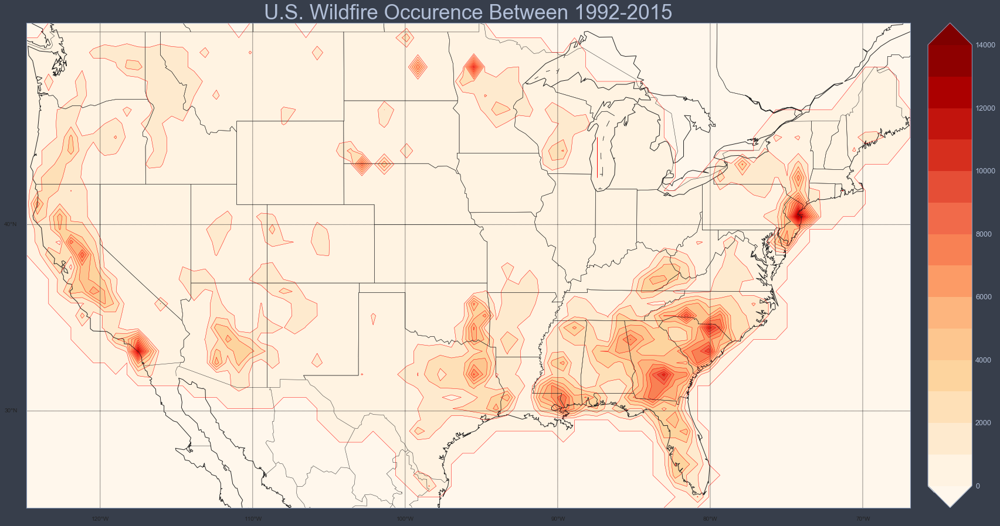

In [32]:
# Dedicate figure sizes and axis
fig = plt.figure(figsize=(28,20))
ax = fig.add_axes([0.1,0.1,0.8,0.8])

# Create polar stereographic Basemap instance.
# 'merc' = Mercator map projection technique used for navigation
m = Basemap(projection='merc',
            lon_0=lon_0, lat_0=90., lat_ts=lat_0,
            llcrnrlat=bbox_ll[0], urcrnrlat=bbox_ur[0],
            llcrnrlon=bbox_ll[1], urcrnrlon=bbox_ur[1],
            rsphere=6371200., resolution='l', area_thresh=10000)

# Draw coastlines, state and country boundaries, edge of map.
m.drawcoastlines()
m.drawstates()
m.drawcountries()

# Draw parallels
parallels = np.arange(0.,90,10.)
m.drawparallels(parallels, labels=[1,0,0,0], fontsize=10)

# Draw meridians
meridians = np.arange(180.,360.,10.)
m.drawmeridians(meridians, labels=[0,0,0,1], fontsize=10)

# Create Contour lines
CS1 = m.contour(lon_bins_2d, lat_bins_2d, density,15, linewidths=0.5, colors='red', latlon=True)

# Fill between contour lines
CS2 = m.contourf(lon_bins_2d, lat_bins_2d, density, CS1.levels, cmap=plt.cm.OrRd, extend='both', latlon=True)

# Draw colorbar
m.colorbar(CS2) 

plt.title('U.S. Wildfire Occurence Between 1992-2015', fontsize=35)
plt.show()

The above contour map displays the latitude and longitude of wildfire occurrence in the continental United States between 1992 and 2015. The map was build with a program called Basemap that uses a parameter known as Mercator, which is a map projection technique used for navigation. Looking into the details of the wildfires within the map, we can see that many wildfire occurrences are found outskirts of Los Angeles and New York City. After looking into the instances, specifically in eastern New York, I found that many of these wildfires burn less than 10 acres, but occur frequently. There are a less than 100 instances in the state of New York that have burned more than 100 acres during this timespan. 


Looking at the rest of the country, it's unsurprising the western portion of the U.S. contains various instances of Wildfires. It is surprising, however, that the southeastern portion of the U.S. contains the most occurrences of location. The Carolinas, Georgia, and into Mississippi each contain close to 10,000 instances of wildfires. These southeastern wildfires burn in the mid-late spring when burning conditions are at their peak. In 2016 (post-dataset) there was an epidemic of 33 wildfires that had burned about 90,000 acres between the states of NC, TN, and GA. East Texas and Oklahoma are also a hot spot for wildfires. 

## 2006 Wildfires

In [18]:
# Write a SQL query to identify the worst year for wildfires
year_df = pd.read_sql_query("""
                        SELECT FIRE_NAME, FIRE_YEAR, STATE, FIRE_SIZE_CLASS, FIRE_SIZE
                        FROM Fires 
                        ORDER BY FIRE_YEAR DESC
                        """, engine)
year_df.head()

2019-09-08 18:50:17,312 INFO sqlalchemy.engine.base.Engine 
                        SELECT FIRE_NAME, FIRE_YEAR, STATE, FIRE_SIZE_CLASS, FIRE_SIZE
                        FROM Fires 
                        ORDER BY FIRE_YEAR DESC
                        
2019-09-08 18:50:17,313 INFO sqlalchemy.engine.base.Engine ()


,FIRE_NAME,FIRE_YEAR,STATE,FIRE_SIZE_CLASS,FIRE_SIZE
0,LINCOLN,2015,MT,A,0.10
1,BEAR LAKE,2015,MT,G,6313.00
2,GREY,2015,MT,A,0.25
3,JUMBO MOUNTAIN,2015,MT,A,0.10
4,DEADMAN TRAIL,2015,MT,A,0.10


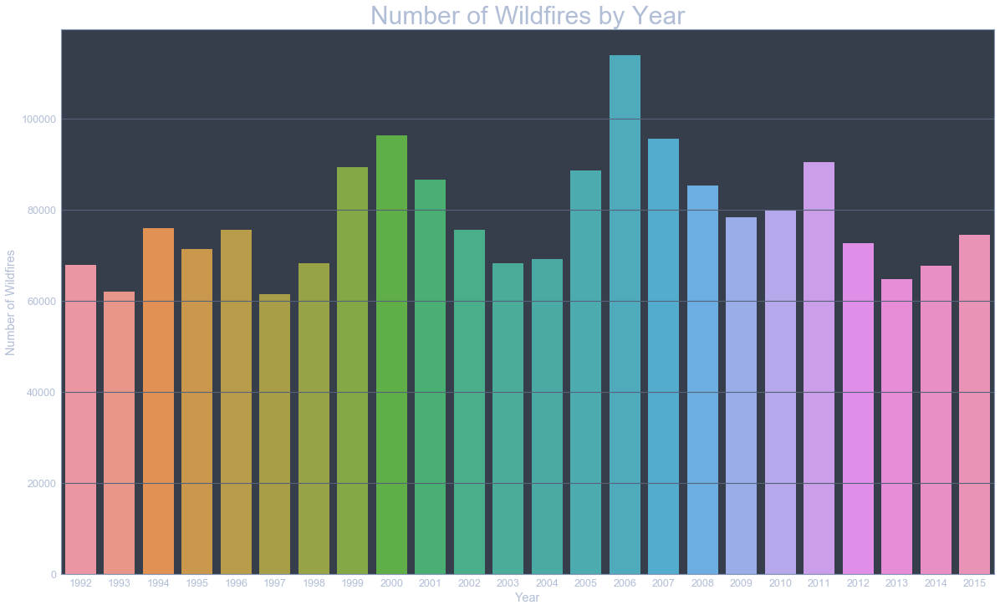

In [19]:
# Plot the initial class for the dataset
x = year_df['FIRE_YEAR']
plt.figure(figsize=(20,12))
ax = sns.countplot(x=x, data=year_df)
plt.title('Number of Wildfires by Year', fontsize=30)
plt.xlabel('Year')
plt.ylabel('Number of Wildfires')
plt.show()

In [20]:
# Print the number of wildfires per year 
print(year_df['FIRE_YEAR'].value_counts())

2006    114004
2000     96416
2007     95573
2011     90552
1999     89363
2005     88604
2001     86587
2008     85378
2010     79889
2009     78325
1994     75955
2002     75656
1996     75574
2015     74491
2012     72769
1995     71472
2004     69279
1998     68370
2003     68261
1992     67975
2014     67753
2013     64780
1993     61989
1997     61450
Name: FIRE_YEAR, dtype: int64


The worst year for wildfires, in terms of the number of fires reported, was 2006. It seems this year out numbers other years by over 17,000 reported fires. It could be of use to identify the locations of these fires over the time span of 2006. This can be done using an animation plot. In building this plot, the animated map will show how wildfires spread over the country in 2006 with a frame for each day of the year.

In [21]:
# Write a SQL query to read all fires in the continental US (excluding Alaska) from 2015 into dataframe)
ani_df = pd.read_sql_query('''
                    SELECT LATITUDE, LONGITUDE, FIRE_SIZE_CLASS, DISCOVERY_DOY, CONT_DOY 
                    From Fires 
                    WHERE FIRE_YEAR=2006 
                    AND CONT_DOY IS NOT NULL
                    AND DISCOVERY_DOY <= CONT_DOY
                    AND DISCOVERY_DOY IS NOT NULL 
                    AND LATITUDE IS NOT NULL
                    AND LONGITUDE IS NOT NULL
                    AND LATITUDE BETWEEN 25 AND 50
                    AND LONGITUDE BETWEEN -125 AND -67
                    ''',engine)
ani_df.info()

2019-09-08 18:50:25,010 INFO sqlalchemy.engine.base.Engine 
                    SELECT LATITUDE, LONGITUDE, FIRE_SIZE_CLASS, DISCOVERY_DOY, CONT_DOY 
                    From Fires 
                    WHERE FIRE_YEAR=2006 
                    AND CONT_DOY IS NOT NULL
                    AND DISCOVERY_DOY <= CONT_DOY
                    AND DISCOVERY_DOY IS NOT NULL 
                    AND LATITUDE IS NOT NULL
                    AND LONGITUDE IS NOT NULL
                    AND LATITUDE BETWEEN 25 AND 50
                    AND LONGITUDE BETWEEN -125 AND -67
                    
2019-09-08 18:50:25,011 INFO sqlalchemy.engine.base.Engine ()
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40395 entries, 0 to 40394
Data columns (total 5 columns):
LATITUDE           40395 non-null float64
LONGITUDE          40395 non-null float64
FIRE_SIZE_CLASS    40395 non-null object
DISCOVERY_DOY      40395 non-null int64
CONT_DOY           40395 non-null int64
dtypes: float64(2), int64(2), object(

In [22]:
# Write a function thatreturns the location and size of wildfires active on days of the year
def active_fires(doy):
    return ani_df[(ani_df['DISCOVERY_DOY'] <= doy) & (ani_df['CONT_DOY'] >= doy)]

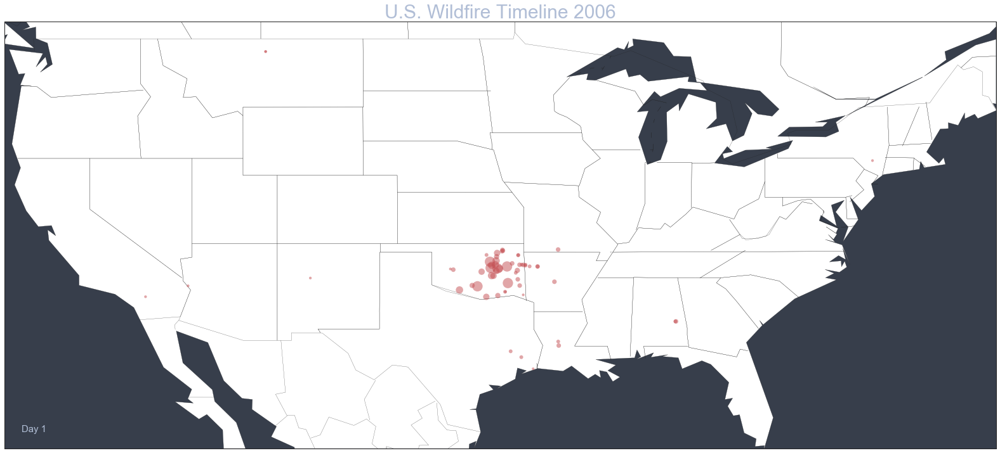

In [23]:
# Build the animation. This code will show a static image. 
# The animation needs to be saved and will then show correctly.
# The animation will display the wildfires that were active during that day. The markers are sized to distinguish 
# smaller fires from bigger ones
fig = plt.figure(figsize=(28,20))
    
map = Basemap(projection='cyl', llcrnrlat=25, urcrnrlat=50,
            llcrnrlon=-125, urcrnrlon=-67)

map.drawcoastlines(linewidth=0.25)
map.drawcountries(linewidth=0.25)
map.drawstates(linewidth=0.25)
map.drawmapboundary()
map.fillcontinents(color='white', zorder=1)

scat = map.scatter([], [])
day_label = plt.text(-124,26,'Day 1', fontsize=15)
def anim(frame_number):
    day = frame_number+1
    fires_this_day = active_fires(day)
    xs, ys = map(fires_this_day['LONGITUDE'], fires_this_day['LATITUDE'])
    data = np.dstack((xs, ys))[0]
    scat.set_color('r')
    scat.set_alpha(0.5)
    scat.set_zorder(10)
    scat.set_sizes(fires_this_day['FIRE_SIZE_CLASS'].map({'A':16,'B':32,'C':48,'D':64,'E':96,'F':128,'G':256}))
    scat.set_offsets(data)
    day_label.set_text("Day {}".format(day))
    return scat

anim = animation.FuncAnimation(fig, anim, interval=100, frames=365, repeat=False)
plt.title('U.S. Wildfire Timeline 2006', fontsize=30)
plt.show()

In [24]:
## Save the animation as a newfile within the notebook folder
# anim.save('fire_animation.gif', writer='imagemagick', fps=5)


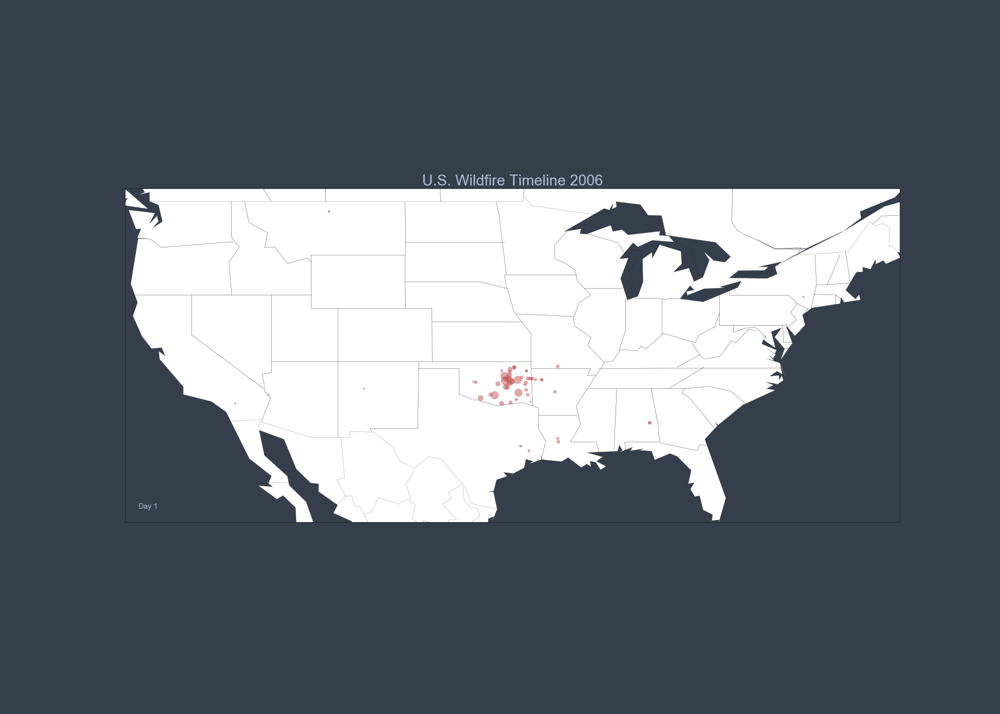

In [25]:
# Display the new animation image within the notebook
from IPython.display import HTML
import io
import base64

filename = 'fire_animation.gif'

video = io.open(filename, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<img src="data:image/gif;base64,{0}" type="gif" />'''.format(encoded.decode('ascii')))

In the beginning of the year, wildfires are concentrated in the north and southeastern regions of the United States. The states of Oklahoma, Alabama, and New York seem to have concentrated wildfires within the state. Although neighboring states contain instances of wildfires, the concentration within these three states could be due to the reporting tactics used.


As we move forward in the year 2006, the magnitude and quantity of wildfires shift towards the west. Notice the size of these fires compared to the east - they are much larger. In the middle of the year, the southwestern states of Utah, Nevada, and Arizona share the brunt of the wildfires. Then around day 220 (early august) the wildfires become much more prevalent in the northwestern states. Idaho and Montana experience severe wildfires towards the end of the year.


With this animation, it's important to notice the shift of fires within the country, starting from the east and moving towards the west. Around the midpoint of the year is when we begin to see wildfires becoming much more prevalent in the western states, with the severity increasing as days go by. 

## Fire Departments

In [36]:
# Write a SQL query to display the names of reporting department units
dept_df = pd.read_sql_query('''
                            SELECT FIRE_NAME, STATE, SOURCE_REPORTING_UNIT_NAME, FIPS_NAME, FIRE_SIZE_CLASS, OWNER_DESCR
                            FROM Fires
                            ORDER BY STATE ASC
                            ''', engine)
dept_df.head()

2019-09-17 22:10:08,198 INFO sqlalchemy.engine.base.Engine 
                            SELECT FIRE_NAME, STATE, SOURCE_REPORTING_UNIT_NAME, FIPS_NAME, FIRE_SIZE_CLASS, OWNER_DESCR
                            FROM Fires
                            ORDER BY STATE ASC
                            


INFO:sqlalchemy.engine.base.Engine:
                            SELECT FIRE_NAME, STATE, SOURCE_REPORTING_UNIT_NAME, FIPS_NAME, FIRE_SIZE_CLASS, OWNER_DESCR
                            FROM Fires
                            ORDER BY STATE ASC
                            


2019-09-17 22:10:08,199 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


,FIRE_NAME,STATE,SOURCE_REPORTING_UNIT_NAME,FIPS_NAME,FIRE_SIZE_CLASS,OWNER_DESCR
0,TONSINA CREEK,AK,Chugach National Forest,Kenai Peninsula,B,STATE OR PRIVATE
1,SHERIDAN GLACIER FIR,AK,Chugach National Forest,Valdez-Cordova,C,OTHER FEDERAL
2,PETERSON CREEK,AK,Chugach National Forest,Kenai Peninsula,B,USFS
3,TWENTY MILE,AK,Chugach National Forest,Kenai Peninsula,A,STATE OR PRIVATE
4,TIRE,AK,Tongass National Forest,Wrangell-Petersburg,A,USFS


In [37]:
# Set a new variable for the purpose of displaying the value counts of 'SOURCE_REPORTING_UNIT_NAME'
dept_vis = dept_df['SOURCE_REPORTING_UNIT_NAME'].value_counts()

In [38]:
# Display all units that have been dispatched over 10,000 times
dept_vis = dept_vis.where(dept_vis>10000).dropna()

Text(0.5, 0, 'Count')

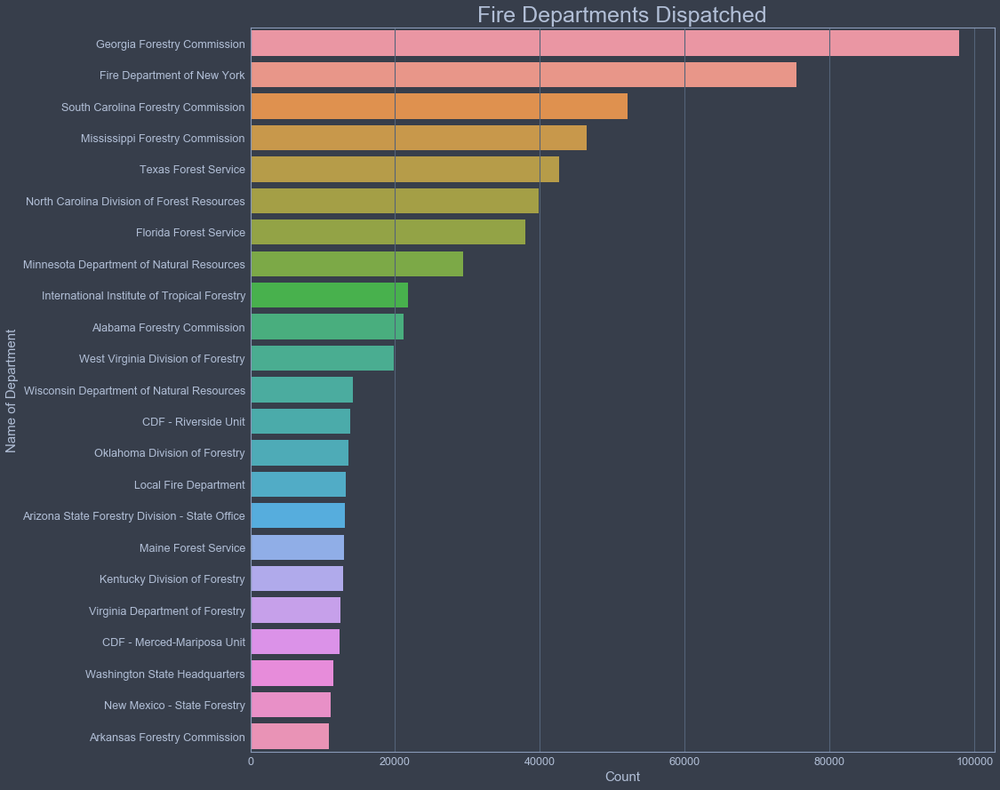

In [39]:
# Plot the value counts
plt.figure(figsize=(15,15))
from jupyterthemes import jtplot
jtplot.style(theme='onedork')

sns.barplot(y=dept_vis.index, x=dept_vis)
plt.title('Fire Departments Dispatched', fontsize=25)
plt.ylabel('Name of Department', fontsize=15)
plt.xlabel('Count', fontsize=15)

In analyzing which fire unit reports to each fire, we can see that the Georgia Forestry Commission is dispatched the most often in the attempt of containing the fires in the U.S. In the timeline since 1992-2015, the Georgia Forestry Commission has been dispatched almost 100,000 times. The next closest reporting unit is the Fire Department of New York, the South Carolina Forestry Commission and the Mississippi Forestry Commission. Surprisingly, the eastern and southeastern wildfire departments are dispatched much more often than the western departments. Now, according to the animation map, it seems there are much larger fires in the western half of the United States. Let's create a new dataframe and analyze which units are reporting to the largest of fires.

In [40]:
# Write a SQL query to display the names of reporting department units
# Where fire size is represented as class 'G' (the largest fire size)
dept_df = pd.read_sql_query('''
                            SELECT FIRE_NAME, STATE, SOURCE_REPORTING_UNIT_NAME, FIPS_NAME, FIRE_SIZE_CLASS, OWNER_DESCR
                            FROM Fires
                            WHERE FIRE_SIZE_CLASS = 'G'
                            ORDER BY STATE ASC
                            ''', engine)
dept_df.head()

2019-09-17 22:10:42,208 INFO sqlalchemy.engine.base.Engine 
                            SELECT FIRE_NAME, STATE, SOURCE_REPORTING_UNIT_NAME, FIPS_NAME, FIRE_SIZE_CLASS, OWNER_DESCR
                            FROM Fires
                            WHERE FIRE_SIZE_CLASS = 'G'
                            ORDER BY STATE ASC
                            


INFO:sqlalchemy.engine.base.Engine:
                            SELECT FIRE_NAME, STATE, SOURCE_REPORTING_UNIT_NAME, FIPS_NAME, FIRE_SIZE_CLASS, OWNER_DESCR
                            FROM Fires
                            WHERE FIRE_SIZE_CLASS = 'G'
                            ORDER BY STATE ASC
                            


2019-09-17 22:10:42,210 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


,FIRE_NAME,STATE,SOURCE_REPORTING_UNIT_NAME,FIPS_NAME,FIRE_SIZE_CLASS,OWNER_DESCR
0,213225,AK,Alaska Fire Service,None,G,STATE
1,BTT 3 48,AK,Alaska Fire Service,None,G,FWS
2,232414,AK,Alaska Fire Service,None,G,FWS
3,304222,AK,Alaska Fire Service,None,G,FWS
4,332229,AK,Alaska Fire Service,None,G,FWS


In [41]:
# Set a new variable for the purpose of displaying the value counts of 'SOURCE_REPORTING_UNIT_NAME'
dept_vis2 = dept_df['SOURCE_REPORTING_UNIT_NAME'].value_counts()

In [42]:
# Display all units that have been dispatched over 10,000 times
dept_vis2 = dept_vis2.where(dept_vis>10000).dropna()

Text(0.5, 0, 'Count')

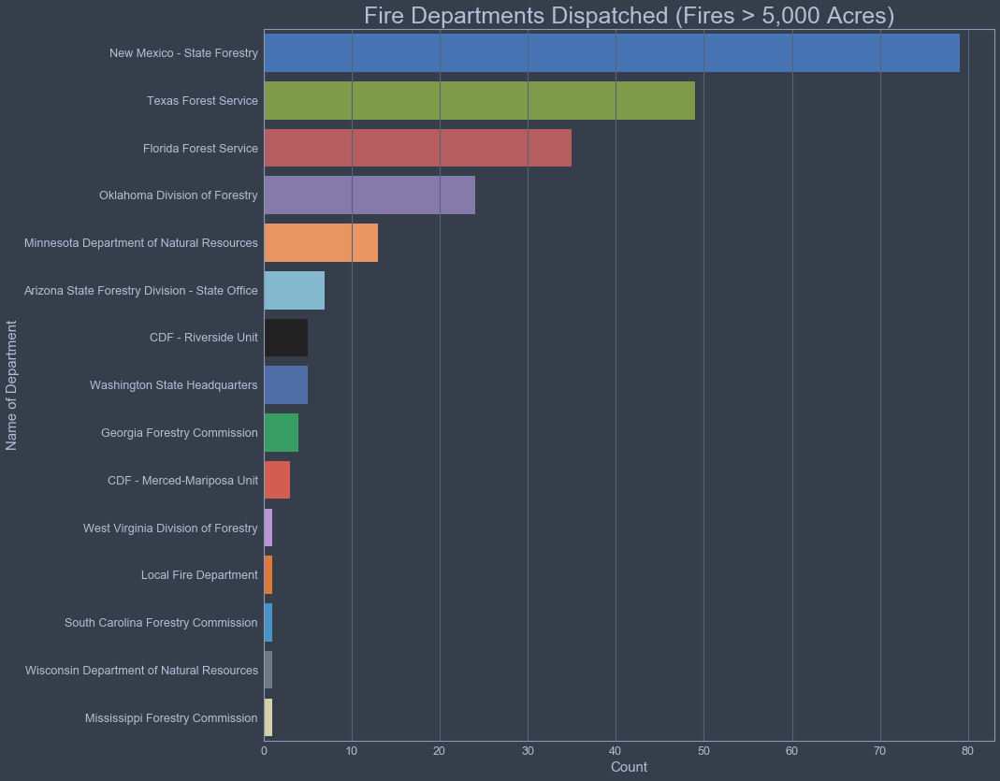

In [44]:
# Plot the value counts
plt.figure(figsize=(14,14))
from jupyterthemes import jtplot
jtplot.style(theme='onedork')

sns.barplot(y=dept_vis2.index, x=dept_vis2)
plt.title('Fire Departments Dispatched (Fires > 5,000 Acres)', fontsize=25)
plt.ylabel('Name of Department', fontsize=15)
plt.xlabel('Count', fontsize=15)

In the above visual, we can see the reporting units that are dispatched to the largest of fires in the Unites States. These fires contain a class 'G' rating, meaning the fires have reached 5,000+ acres. The New Mexico State Forestry  department has been dispatched almost 80 times to fight fires larger than 5,000 acres. Texas and Florida Forest service are next on the list with between 50 and 35 dispatches, respectively. It seems the southwest/west has been dispatched more often to fight larger fires. 

## Causes of Wildfires

In [34]:
# Write a SQL query to display the causes of wildfires
cause_df = pd.read_sql_query('''
                            SELECT STAT_CAUSE_DESCR, STAT_CAUSE_CODE, STATE, DISCOVERY_DATE, CONT_DATE, FIRE_SIZE
                            FROM Fires
                            WHERE STAT_CAUSE_DESCR != 'Miscellaneous'
                            AND STAT_CAUSE_DESCR != 'Missing/Undefined'
                            ORDER BY STATE DESC
                            ''', engine)
cause_df.head()

2019-09-08 18:50:37,417 INFO sqlalchemy.engine.base.Engine 
                            SELECT STAT_CAUSE_DESCR, STAT_CAUSE_CODE, STATE, DISCOVERY_DATE, CONT_DATE, FIRE_SIZE
                            FROM Fires
                            WHERE STAT_CAUSE_DESCR != 'Miscellaneous'
                            AND STAT_CAUSE_DESCR != 'Missing/Undefined'
                            ORDER BY STATE DESC
                            
2019-09-08 18:50:37,418 INFO sqlalchemy.engine.base.Engine ()


,STAT_CAUSE_DESCR,STAT_CAUSE_CODE,STATE,DISCOVERY_DATE,CONT_DATE,FIRE_SIZE
0,Lightning,1.0,WY,2453527.5,2453527.5,0.25
1,Lightning,1.0,WY,2453546.5,2453547.5,0.10
2,Campfire,4.0,WY,2453519.5,2453519.5,0.10
3,Lightning,1.0,WY,2453542.5,2453543.5,0.10
4,Campfire,4.0,WY,2453561.5,2453561.5,0.10


In [35]:
# Set a new variable for the purpose of displaying the value counts of 'STAT_CAUSE_DESCR'
cause_vis = cause_df['STAT_CAUSE_DESCR'].value_counts()

Text(0.5, 0, 'Count')

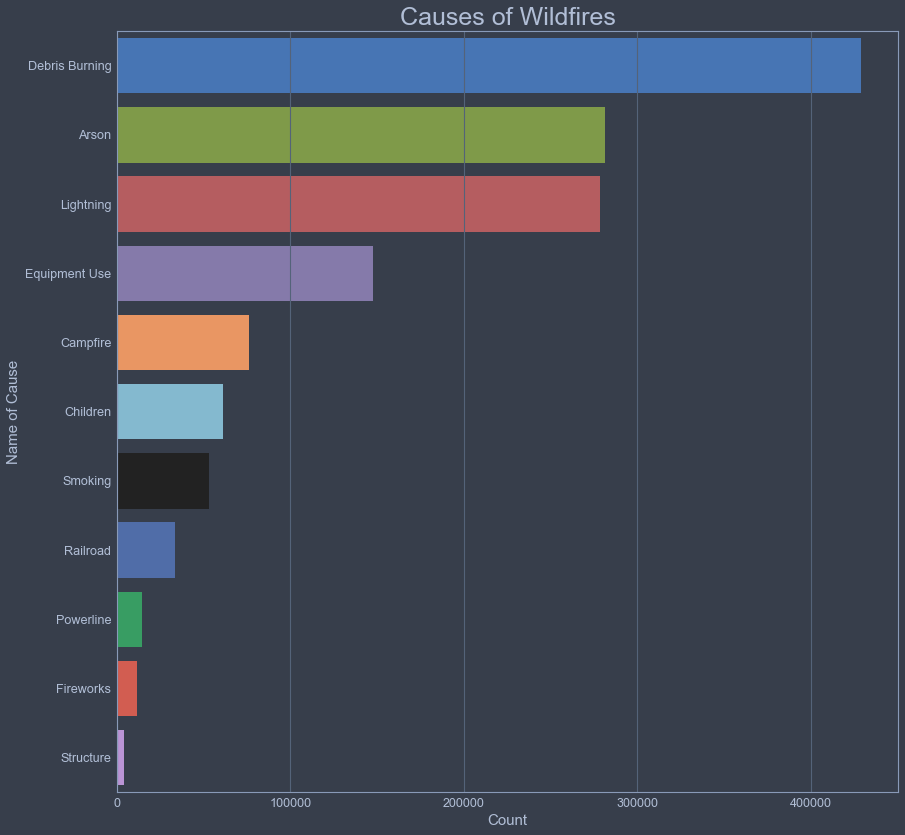

In [36]:
# Plot the causes of wildfires
plt.figure(figsize=(14,14))
sns.barplot(y=cause_vis.index, x=cause_vis)
plt.title('Causes of Wildfires', fontsize=25)
plt.ylabel('Name of Cause', fontsize=15)
plt.xlabel('Count', fontsize=15)

When looking into the causes of fires within the data, it seems that debris burning outnumbers other causes my a sizable margin. Arson comes in second and its an unfortunate cause of wildfires within the United States. Lightning strikes, an unavoidable cause of fires, takes third. Out of the eleven possible causes of wildfires listed within the database, human negligence accounts for nine of them. 

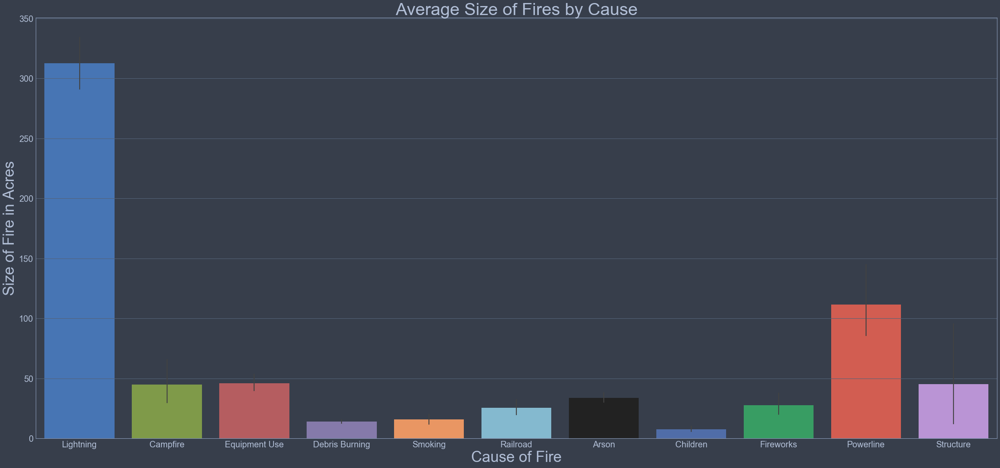

In [37]:
# Create a bar plot to measure the central tendency of wildfires by "cause of fire"
f, ax = plt.subplots(figsize=(40, 18))
sns.barplot(x='STAT_CAUSE_DESCR',y='FIRE_SIZE',data=cause_df)
ax.set_title("Average Size of Fires by Cause", fontsize=40)
ax.set_xlabel("Cause of Fire", fontsize=35)
ax.set_ylabel("Size of Fire in Acres", fontsize=35)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show()

Lightning strikes seem to be, by far and away, the largest contributor to fire size. I would estimate that because lightning strikes occur in randomized areas, it's likely that these strikes occur in very rural areas where 1) Forestry is likely to be dense and 2) It's difficult to contain wildfires in dense forestry/grassland and unpopulated areas. The availability of resources to contain fires like these aren't common. Powerline causes come second, an unfortunate but difficult cause to prevent in the future. These fires could also be started in unpopulated areas. 

In [38]:
# FEATURE ENGINEERING: Convert DISCOVERY_DATE and CONT_DATE to pandas datetime
cause_df['DISCOVERY_DATE'] = pd.to_datetime(cause_df['DISCOVERY_DATE'] - pd.Timestamp(0).to_julian_date(), unit='D')
cause_df['CONT_DATE'] = pd.to_datetime(cause_df['CONT_DATE'] - pd.Timestamp(0).to_julian_date(), unit='D')

In [39]:
# FEATURE ENGINEERING: Convert DISCOVERY_DATE into a column that identifies the day of the week
cause_df['DAY_OF_WEEK'] = cause_df['DISCOVERY_DATE'].dt.weekday_name

Text(0.5, 0, 'Count')

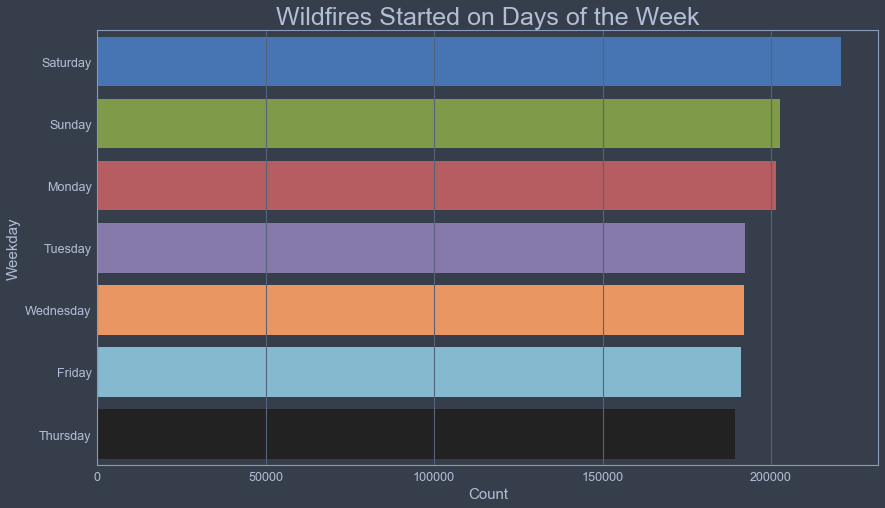

In [40]:
# Plot the most common days of the week a fire has started
day_vis = cause_df['DAY_OF_WEEK'].value_counts()
plt.figure(figsize=(14,8))
sns.barplot(y=day_vis.index, x=day_vis)
plt.title('Wildfires Started on Days of the Week', fontsize=25)
plt.ylabel('Weekday', fontsize=15)
plt.xlabel('Count', fontsize=15)

It seems that most fires are started on the weekends, with Saturday and Sunday being the top two days of the week in the visual above. This should not come as a surprise. I imagine these fires are due to people being careless with campfires, smoking, or fireworks. 

In [41]:
# FEATURE ENGINEERING: Convert DISCOVERY_DATE into a column that identifies the month
cause_df['MONTH'] = cause_df['DISCOVERY_DATE'].dt.strftime("%B")

Text(0.5, 0, 'Count')

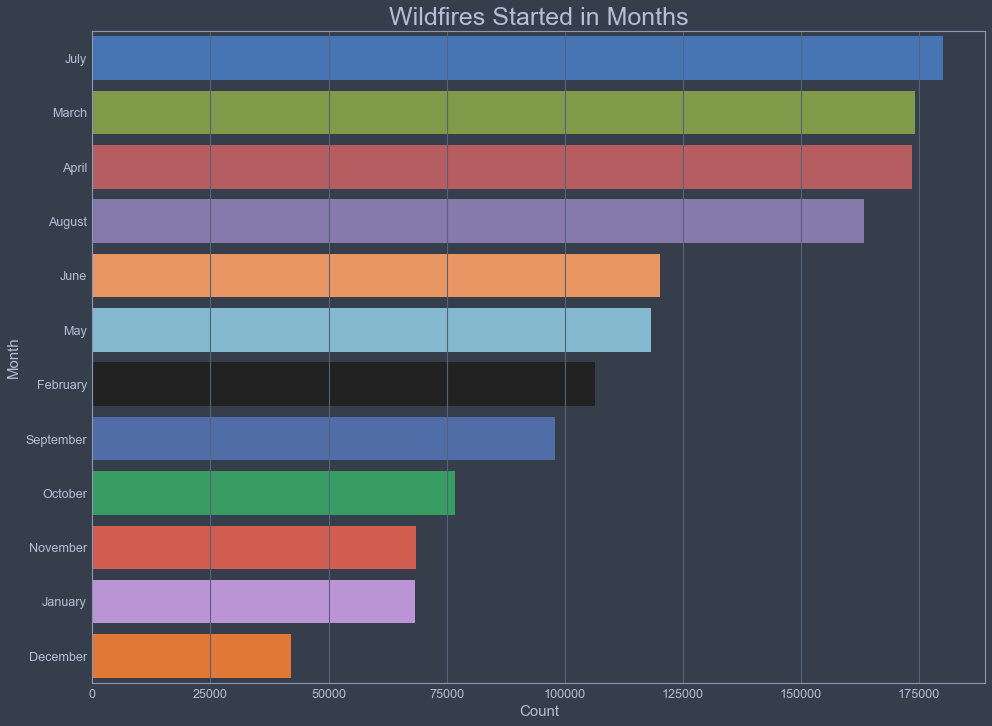

In [42]:
# Plot the month in which fires are stared the most
month_vis = cause_df['MONTH'].value_counts()
plt.figure(figsize=(16,12))
sns.barplot(y=month_vis.index, x=month_vis)
plt.title('Wildfires Started in Months', fontsize=25)
plt.ylabel('Month', fontsize=15)
plt.xlabel('Count', fontsize=15)

Late spring through summer are the months in which most of fires occur throughout the year. This should also not come as a surprise for a few factors. First, the temperature is higher and conditions are more arid leading to spontaneous fires that result from 'debris burning'. Second, people spend more time outside which leads to higher chances of accidental fires. 

## Sizes of Wildfires

In [43]:
# Write a SQL query to identify the sizes of wildfires
size_df = pd.read_sql_query("""
                        SELECT FIRE_NAME, FIRE_YEAR, STATE, FIRE_SIZE_CLASS, FIRE_SIZE, DISCOVERY_DATE, CONT_DATE
                        FROM Fires
                        WHERE DISCOVERY_DATE IS NOT NULL
                        AND CONT_DATE IS NOT NULL
                        ORDER BY FIRE_SIZE DESC
                        """, engine)
size_df.head()

2019-09-08 18:51:31,262 INFO sqlalchemy.engine.base.Engine 
                        SELECT FIRE_NAME, FIRE_YEAR, STATE, FIRE_SIZE_CLASS, FIRE_SIZE, DISCOVERY_DATE, CONT_DATE
                        FROM Fires
                        WHERE DISCOVERY_DATE IS NOT NULL
                        AND CONT_DATE IS NOT NULL
                        ORDER BY FIRE_SIZE DESC
                        
2019-09-08 18:51:31,263 INFO sqlalchemy.engine.base.Engine ()


,FIRE_NAME,FIRE_YEAR,STATE,FIRE_SIZE_CLASS,FIRE_SIZE,DISCOVERY_DATE,CONT_DATE
0,INOWAK,1997,AK,G,606945.0,2450624.5,2450700.5
1,LONG DRAW,2012,OR,G,558198.3,2456116.5,2456138.5
2,WALLOW,2011,AZ,G,538049.0,2455710.5,2455754.5
3,BOUNDARY,2004,AK,G,537627.0,2453169.5,2453278.5
4,MINTO FLATS SOUTH,2009,AK,G,517078.0,2455003.5,2455085.5


Text(0.5, 0, 'Class')

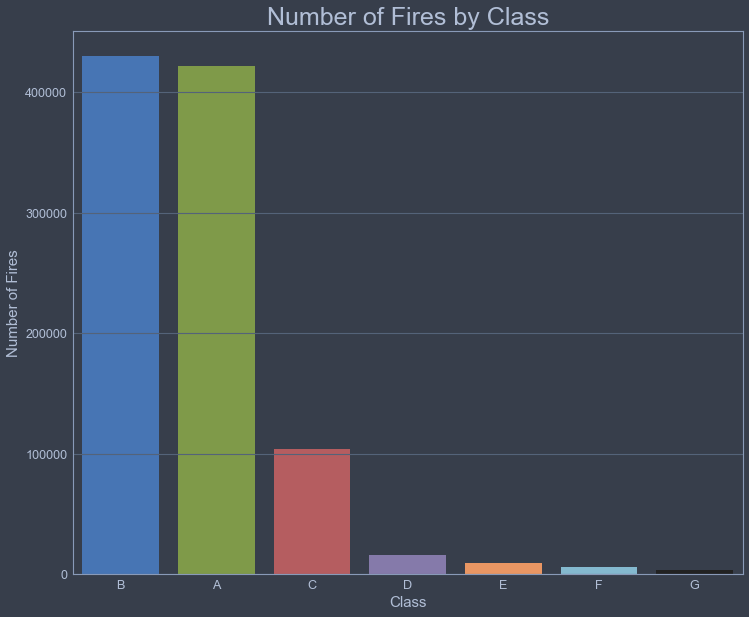

In [44]:
# Plot the Number of Fires by Class
class_vis = size_df['FIRE_SIZE_CLASS'].value_counts()
plt.figure(figsize=(12,10))
sns.barplot(y=class_vis, x=class_vis.index)
plt.title('Number of Fires by Class', fontsize=25)
plt.ylabel('Number of Fires', fontsize=15)
plt.xlabel('Class', fontsize=15)

Class 'B' fires are the most prevalent fires in the U.S. these fires are considered to burn 0.26-9.9 acres of land. So when imagining the severity of class B fires, they do not appear to cause intensive damage to surrounding land or urban areas. Class 'A' fires come second, burning less than 1/4 of an acre. These fires are the smallest classification and are contained in a quick manner. Thereon, fires follow a descending pattern in terms of class names with class 'G' being the least common. 

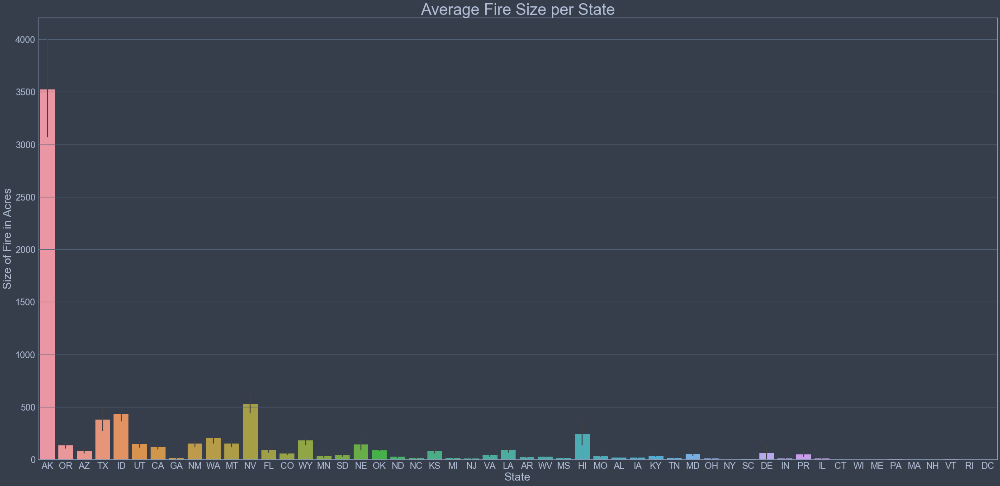

In [289]:
# Plot the Average Size of Fires per State
f, ax = plt.subplots(figsize=(38, 18))
sns.barplot(x='STATE',y='FIRE_SIZE',data=size_df)
ax.set_title("Average Fire Size per State", fontsize=35)
ax.set_xlabel("State", fontsize=25)
ax.set_ylabel("Size of Fire in Acres", fontsize=25)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show()

As mentioned before in this project, Alaska houses the largest average size of fire by state. The average fire totals over 3,500 acres. This is much, much larger than any other state in the country. This is likely contributed to the rural nature of the state, where lightning strikes could cause fires to burn for miles without any chance of containment. Hawaii is an interesting case, where the average fire burns for almost 250 acres. Fires are uncommon in Hawaii, but when they occur, they burn for much longer than typical continental U.S. states. 

In the continental U.S., Nevada leads the largest average fire with over 500 acres burned. Idaho and Texas are second and third. These results can be seen on the animation map created for the year 2006. 

In [58]:
# FEAUTRE ENGINEERING: Create a new column that identifies the time it took for the fire to become contained
size_df['CONT_TIME'] = size_df['CONT_DATE'] - size_df['DISCOVERY_DATE']

size_df.head()

,FIRE_NAME,FIRE_YEAR,STATE,FIRE_SIZE_CLASS,FIRE_SIZE,DISCOVERY_DATE,CONT_DATE,CONT_TIME
0,INOWAK,1997,AK,G,606945.0,2450624.5,2450700.5,76.0
1,LONG DRAW,2012,OR,G,558198.3,2456116.5,2456138.5,22.0
2,WALLOW,2011,AZ,G,538049.0,2455710.5,2455754.5,44.0
3,BOUNDARY,2004,AK,G,537627.0,2453169.5,2453278.5,109.0
4,MINTO FLATS SOUTH,2009,AK,G,517078.0,2455003.5,2455085.5,82.0


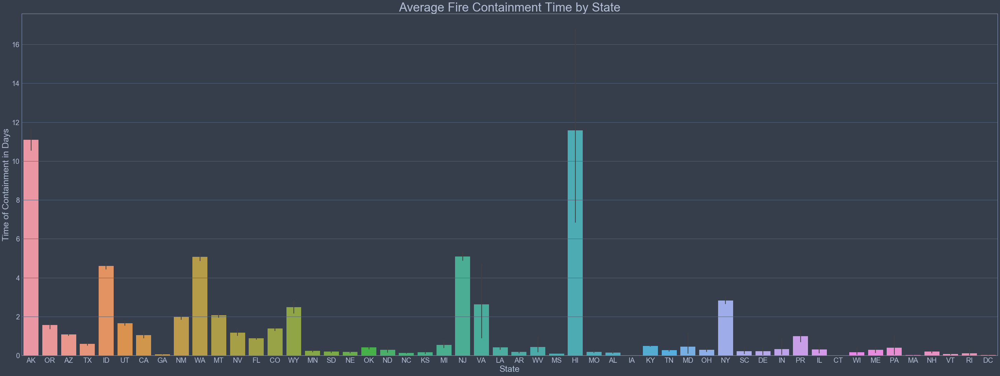

In [59]:
# Plot the Average Fire Containment Time per State
f, ax = plt.subplots(figsize=(50, 18))
sns.barplot(x='STATE',y='CONT_TIME',data=size_df)
ax.set_title("Average Fire Containment Time per State", fontsize=35)
ax.set_xlabel("State", fontsize=25)
ax.set_ylabel("Time of Containment in Days", fontsize=25)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
plt.show()

Once again, the non-continental states surprise with the largest average fire containment time per state. The fires in these two states burn around 11-12 days. Within continental states, Washington, Idaho, and New Jersey take the most time to contain fires. It seems as if these could use improvement in containing fires, possibly a point of emphasis for fire departments within each state. The average times for Virginia and New York, decently populous states, are surprising as well.

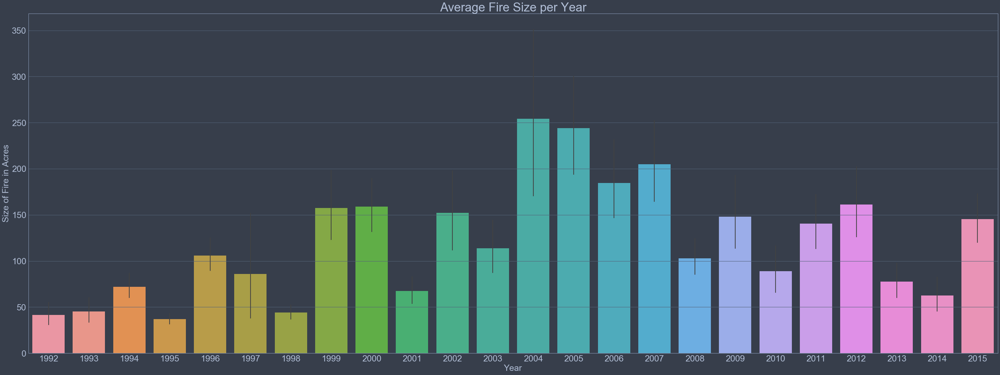

In [278]:
# Plot the Average Size of Fires per State
f, ax = plt.subplots(figsize=(50, 18))
sns.barplot(x='FIRE_YEAR',y='FIRE_SIZE',data=size_df)
ax.set_title("Average Fire Size per Year", fontsize=35)
ax.set_xlabel("Year", fontsize=25)
ax.set_ylabel("Size of Fire in Acres", fontsize=25)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
plt.show()

It seems the years 2004-2007 provided the largest average fire sizes, in acres, within the time frame of this dataset. 2004 and 2005 contain the largest average fire size per year.

## Correlation Matrix

In [47]:
# Write a SQL query for the correlation dataframe
corr_df = pd.read_sql_query('''
                            SELECT FIRE_NAME, FIRE_YEAR, DISCOVERY_DATE, STAT_CAUSE_DESCR, 
                            CONT_DATE, FIRE_SIZE, LATITUDE, LONGITUDE, STATE 
                            FROM Fires
                            ORDER BY FIRE_SIZE DESC''', engine)
corr_df.head()

2019-09-08 18:51:52,420 INFO sqlalchemy.engine.base.Engine 
                            SELECT FIRE_NAME, FIRE_YEAR, DISCOVERY_DATE, STAT_CAUSE_DESCR, 
                            CONT_DATE, FIRE_SIZE, LATITUDE, LONGITUDE, STATE 
                            FROM Fires
                            ORDER BY FIRE_SIZE DESC
2019-09-08 18:51:52,421 INFO sqlalchemy.engine.base.Engine ()


,FIRE_NAME,FIRE_YEAR,DISCOVERY_DATE,STAT_CAUSE_DESCR,CONT_DATE,FIRE_SIZE,LATITUDE,LONGITUDE,STATE
0,INOWAK,1997,2450624.5,Lightning,2450700.5,606945.0,61.982700,-157.085700,AK
1,LONG DRAW,2012,2456116.5,Lightning,2456138.5,558198.3,42.391894,-117.893687,OR
2,WALLOW,2011,2455710.5,Campfire,2455754.5,538049.0,33.606111,-109.449722,AZ
3,BOUNDARY,2004,2453169.5,Lightning,2453278.5,537627.0,65.266300,-146.885800,AK
4,MINTO FLATS SOUTH,2009,2455003.5,Lightning,2455085.5,517078.0,64.746700,-149.504700,AK


In [60]:
# FEAUTRE ENGINEERING: Create a new column that identifies the time it took for the fire to become contained
corr_df['CONT_TIME'] = corr_df['CONT_DATE'] - corr_df['DISCOVERY_DATE']

In [61]:
# Create a new datetime column for each DISCOVERY_DATE and CONT_DATE
corr_df['FIRE_DISC_DATE'] = pd.to_datetime(corr_df['DISCOVERY_DATE'] - pd.Timestamp(0).to_julian_date(), unit='D')
corr_df['FIRE_CONT_DATE'] = pd.to_datetime(corr_df['CONT_DATE'] - pd.Timestamp(0).to_julian_date(), unit='D')

In [62]:
# Display the new df
corr_df.head()

,FIRE_NAME,FIRE_YEAR,DISCOVERY_DATE,STAT_CAUSE_DESCR,CONT_DATE,FIRE_SIZE,LATITUDE,LONGITUDE,STATE,CONT_TIME,FIRE_DISC_DATE,FIRE_CONT_DATE
0,INOWAK,1997,2450624.5,Lightning,2450700.5,606945.0,61.982700,-157.085700,AK,76.0,1997-06-25,1997-09-09
1,LONG DRAW,2012,2456116.5,Lightning,2456138.5,558198.3,42.391894,-117.893687,OR,22.0,2012-07-08,2012-07-30
2,WALLOW,2011,2455710.5,Campfire,2455754.5,538049.0,33.606111,-109.449722,AZ,44.0,2011-05-29,2011-07-12
3,BOUNDARY,2004,2453169.5,Lightning,2453278.5,537627.0,65.266300,-146.885800,AK,109.0,2004-06-13,2004-09-30
4,MINTO FLATS SOUTH,2009,2455003.5,Lightning,2455085.5,517078.0,64.746700,-149.504700,AK,82.0,2009-06-21,2009-09-11


In [63]:
# FEAUTRE ENGINEERING: Create a new column for discovery month
corr_df['DISC_MONTH'] = pd.DatetimeIndex(corr_df['FIRE_DISC_DATE']).month

In [64]:
# FEAUTRE ENGINEERING: Create a new column for discovery day of week
corr_df['DISC_DAY_OF_WEEK'] = corr_df['FIRE_DISC_DATE'].dt.weekday_name

In [65]:
# FEAUTRE ENGINEERING: Label encode the columns for numerical calculations
le = preprocessing.LabelEncoder()
corr_df['STAT_CAUSE_DESCR'] = le.fit_transform(corr_df['STAT_CAUSE_DESCR'])
corr_df['STATE'] = le.fit_transform(corr_df['STATE'])
corr_df['DISC_DAY_OF_WEEK'] = le.fit_transform(corr_df['DISC_DAY_OF_WEEK'])

In [66]:
# Display the new df
corr_df.head()

,FIRE_NAME,FIRE_YEAR,DISCOVERY_DATE,STAT_CAUSE_DESCR,CONT_DATE,FIRE_SIZE,LATITUDE,LONGITUDE,STATE,CONT_TIME,FIRE_DISC_DATE,FIRE_CONT_DATE,DISC_MONTH,DISC_DAY_OF_WEEK
0,INOWAK,1997,2450624.5,6,2450700.5,606945.0,61.982700,-157.085700,0,76.0,1997-06-25,1997-09-09,6,6
1,LONG DRAW,2012,2456116.5,6,2456138.5,558198.3,42.391894,-117.893687,37,22.0,2012-07-08,2012-07-30,7,3
2,WALLOW,2011,2455710.5,1,2455754.5,538049.0,33.606111,-109.449722,3,44.0,2011-05-29,2011-07-12,5,3
3,BOUNDARY,2004,2453169.5,6,2453278.5,537627.0,65.266300,-146.885800,0,109.0,2004-06-13,2004-09-30,6,3
4,MINTO FLATS SOUTH,2009,2455003.5,6,2455085.5,517078.0,64.746700,-149.504700,0,82.0,2009-06-21,2009-09-11,6,3


In [71]:
# Drop the FIRE_YEAR and CONT_DATE columns
corr_df = corr_df.drop('FIRE_YEAR', axis = 1)
corr_df = corr_df.drop('CONT_DATE', axis = 1)

In [81]:
# Display the new df
corr_df.head()

,FIRE_NAME,DISCOVERY_DATE,STAT_CAUSE_DESCR,FIRE_SIZE,LATITUDE,LONGITUDE,STATE,CONT_TIME,FIRE_DISC_DATE,FIRE_CONT_DATE,DISC_MONTH,DISC_DAY_OF_WEEK
0,INOWAK,2450624.5,6,606945.0,61.982700,-157.085700,0,76.0,1997-06-25,1997-09-09,6,6
1,LONG DRAW,2456116.5,6,558198.3,42.391894,-117.893687,37,22.0,2012-07-08,2012-07-30,7,3
2,WALLOW,2455710.5,1,538049.0,33.606111,-109.449722,3,44.0,2011-05-29,2011-07-12,5,3
3,BOUNDARY,2453169.5,6,537627.0,65.266300,-146.885800,0,109.0,2004-06-13,2004-09-30,6,3
4,MINTO FLATS SOUTH,2455003.5,6,517078.0,64.746700,-149.504700,0,82.0,2009-06-21,2009-09-11,6,3


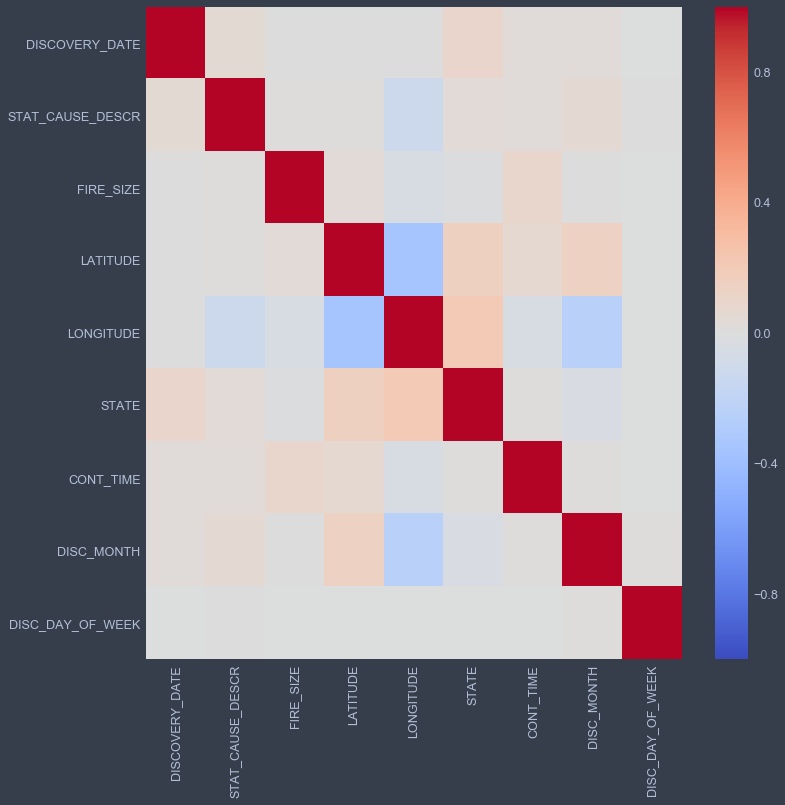

In [80]:
# Plot the new correlation matrix based upon the created dataframe 'corr_df'
plt.figure(figsize=(12,12))
sns.heatmap(corr_df.corr(), 
            cmap='coolwarm', 
            vmin=-1, vmax=1)

When analyzing this correlation matrix, there are no features that have strong correlations, or at least correlations greater than 0.4. It's interesting to note that containment time (CONT_TIME) has a slight correlation with latitude, and also fire size. It's clear that containment time should relate to fire size, but it's nice to see that represented visually. Latitude and discovery month also has an interesting correlation of about 0.3. State and discovery date also share a slight correlation. 

# **Machine Learning**

Machine Learning (ML) is defined as the use algorithms and computational statistics to learn from data without being explicitly programmed. It is a subsection of the artificial intelligence domain within computer science. Depending on what you are trying to accomplish, there are many different ways to get a computer to learn from data. These various ways can be categorized into three main subsections of machine learning: supervised learning, unsupervised learning and reinforcement learning. Here, we will be using supervised learning. A supervised learning algorithm takes labeled data and creates a model that can make predictions given new data.

## Predicting Cause of Wildfires

For this machine learning algorithm, I would like to try to predict the causes of wildfires in the United States. In doing so, this could help response units pinpoint the causation and understand whether a fire was started through natural causes or malicious human action. To accomplish this, I will need to predict the cause of the fire using the variable 'STAT_CAUSE_DESCR' which includes several numerical labels that identify how the fire began. Since I'll be using supervised learning, I need to create training and test datasets.

### Model Preparation

In [123]:
# Display the current dataframe
corr_df.head()

,FIRE_NAME,DISCOVERY_DATE,STAT_CAUSE_DESCR,FIRE_SIZE,LATITUDE,LONGITUDE,STATE,CONT_TIME,FIRE_DISC_DATE,FIRE_CONT_DATE,DISC_MONTH,DISC_DAY_OF_WEEK
0,INOWAK,2450624.5,6,606945.0,61.982700,-157.085700,0,76.0,1997-06-25,1997-09-09,6,6
1,LONG DRAW,2456116.5,6,558198.3,42.391894,-117.893687,37,22.0,2012-07-08,2012-07-30,7,3
2,WALLOW,2455710.5,1,538049.0,33.606111,-109.449722,3,44.0,2011-05-29,2011-07-12,5,3
3,BOUNDARY,2453169.5,6,537627.0,65.266300,-146.885800,0,109.0,2004-06-13,2004-09-30,6,3
4,MINTO FLATS SOUTH,2455003.5,6,517078.0,64.746700,-149.504700,0,82.0,2009-06-21,2009-09-11,6,3


In [124]:
# Drop unnecessary columns that are redundant for the model
mlcause_df = corr_df.drop('FIRE_NAME', axis=1)
mlcause_df = mlcause_df.drop('FIRE_DISC_DATE', axis=1)
mlcause_df = mlcause_df.drop('FIRE_CONT_DATE', axis=1)

In [125]:
# Display the new dataframe
mlcause_df.head()

,DISCOVERY_DATE,STAT_CAUSE_DESCR,FIRE_SIZE,LATITUDE,LONGITUDE,STATE,CONT_TIME,DISC_MONTH,DISC_DAY_OF_WEEK
0,2450624.5,6,606945.0,61.982700,-157.085700,0,76.0,6,6
1,2456116.5,6,558198.3,42.391894,-117.893687,37,22.0,7,3
2,2455710.5,1,538049.0,33.606111,-109.449722,3,44.0,5,3
3,2453169.5,6,537627.0,65.266300,-146.885800,0,109.0,6,3
4,2455003.5,6,517078.0,64.746700,-149.504700,0,82.0,6,3


In [126]:
# Identify null values
mlcause_df.isna().any()

DISCOVERY_DATE      False
STAT_CAUSE_DESCR    False
FIRE_SIZE           False
LATITUDE            False
LONGITUDE           False
STATE               False
CONT_TIME            True
DISC_MONTH          False
DISC_DAY_OF_WEEK    False
dtype: bool

In [127]:
# Count the null values
mlcause_df.isna().sum()

DISCOVERY_DATE           0
STAT_CAUSE_DESCR         0
FIRE_SIZE                0
LATITUDE                 0
LONGITUDE                0
STATE                    0
CONT_TIME           891531
DISC_MONTH               0
DISC_DAY_OF_WEEK         0
dtype: int64

In [128]:
# Replace the null values with a '1'
# These null values are a result of the containment day being the same as discovery day 
# (fires that began and ended in the same day)
mlcause_df.CONT_TIME = mlcause_df.CONT_TIME.fillna(value=1.0)

In [129]:
mlcause_df.head()

,DISCOVERY_DATE,STAT_CAUSE_DESCR,FIRE_SIZE,LATITUDE,LONGITUDE,STATE,CONT_TIME,DISC_MONTH,DISC_DAY_OF_WEEK
0,2450624.5,6,606945.0,61.982700,-157.085700,0,76.0,6,6
1,2456116.5,6,558198.3,42.391894,-117.893687,37,22.0,7,3
2,2455710.5,1,538049.0,33.606111,-109.449722,3,44.0,5,3
3,2453169.5,6,537627.0,65.266300,-146.885800,0,109.0,6,3
4,2455003.5,6,517078.0,64.746700,-149.504700,0,82.0,6,3


In [130]:
# Create new dataframes with and without 'STAT_CAUSE_DESCR'
X = mlcause_df.drop(['STAT_CAUSE_DESCR'], axis=1).values
y = mlcause_df['STAT_CAUSE_DESCR'].values

In [131]:
# Perform a train/test split on the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0) #30% for testing, 70% for training

### Default Random Forest

Random forest, like its name implies, consists of a large number of individual decision trees that operate as an ensemble. Each individual tree in the random forest spits out a class prediction and the class with the most votes becomes our models' prediction. The fundamental concept behind random forest is a simple but powerful one — the reason that the random forest model works so well is that s large number of relatively uncorrelated models (trees) operating as a committee will outperform any of the individual constituent models. The trees protect each other from their individual errors (as long as they don’t constantly all err in the same direction). While some trees may be wrong, many other trees will be right, so as a group the trees are able to move in the correct direction.

In [135]:
# Initialize RandomForestClassifier from SkLearn
rfc_model = RandomForestClassifier(n_estimators=50)

In [136]:
# Fit the model on the X_train and y_train data
rfc_model.fit(X_train,y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=50, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [138]:
# Print the model score based upon the random forest classifier
print(rfc_model.score(X_test,y_test))

0.5831726167263446


When training the model on the selected features, we achieved an 58% accuracy score. This is not sufficient to correctly identify the causation of fires when we pass in future data. However, this is a baseline model. Maybe there are some features we can edit in order for the model to perform better. We shall do this in the following iteration. 

### Improved Random Forest

There are a lot of different classes that are difficult for the random forest to identify. Some of these scores are redundant and unimportant for human interpretation. I want to put consolidate these classes and test again to see if the score improves.

The new model will take into account four labels, each with the following details:

**Label 0 = Natural** 
* Lightning
* Debris Burning

**Label 1 = Arson**
* Arson

**Label 2 = Negligence**
* Campfire
* Children
* FIreworks
* Smoking

**Label 3 = Infrastructure**
* Equipment Use
* Powerline
* Railroad
* Structure

In [143]:
# FEATURE ENGINEERING: Set 4 new labels to account for all STAT_CAUSE_DESCR labels
def set_label(cat):
    cause = 0
    natural = [6, 3]
    arson = [0]
    negligence = [1, 2, 5, 9]
    infrastructure = [4, 7, 8, 11]
    if cat in natural:
        cause = 1
    elif cat in arson:
        cause = 2
    elif cat in negligence:
        cause = 3
    else:
        cause = 4
    return cause
     

mlcause_df['STAT_CAUSE_LABEL'] = mlcause_df['STAT_CAUSE_DESCR'].apply(lambda x: set_label(x)) # I created a copy of the original df earlier in the kernel
mlcause_df = mlcause_df.drop('STAT_CAUSE_DESCR',axis=1)
print(mlcause_df.head())

   DISCOVERY_DATE  FIRE_SIZE   LATITUDE   LONGITUDE  STATE  CONT_TIME  \
0       2450624.5   606945.0  61.982700 -157.085700      0       76.0   
1       2456116.5   558198.3  42.391894 -117.893687     37       22.0   
2       2455710.5   538049.0  33.606111 -109.449722      3       44.0   
3       2453169.5   537627.0  65.266300 -146.885800      0      109.0   
4       2455003.5   517078.0  64.746700 -149.504700      0       82.0   

   DISC_MONTH  DISC_DAY_OF_WEEK  STAT_CAUSE_LABEL  
0           6                 6                 1  
1           7                 3                 1  
2           5                 3                 3  
3           6                 3                 1  
4           6                 3                 1  


In [144]:
# Create new dataframes with and without 'STAT_CAUSE_LABEL'
X = mlcause_df.drop(['STAT_CAUSE_LABEL'], axis=1).values
y = mlcause_df['STAT_CAUSE_LABEL'].values

In [145]:
# Perform a train/test split on the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

In [146]:
# Initialize RandomForestClassifier from SkLearn
# Fit the model on the X_train and y_train data
rfc_model2 = RandomForestClassifier(n_estimators=50)
rfc_model2 = rfc_model2.fit(X_train, y_train)

In [147]:
# Print the model score based upon the random forest classifier
print(rfc_model2.score(X_test,y_test))

0.6573598752082817


Reducing the number of labels improved the random forest classification score, from around 58% to 66%. The prediction score is a good metric to measure success but we can look at other metrics.

In [150]:
# Display the confusion matrix
y_pred = rfc_model2.fit(X_train, y_train).predict(X_test)
cm = confusion_matrix(y_true = y_test, y_pred = y_pred)
print(cm)

[[158830  14853   4155  34136]
 [ 24486  41803   1698  16864]
 [ 17569   3300  12152  16021]
 [ 45992   9175   5536 157570]]


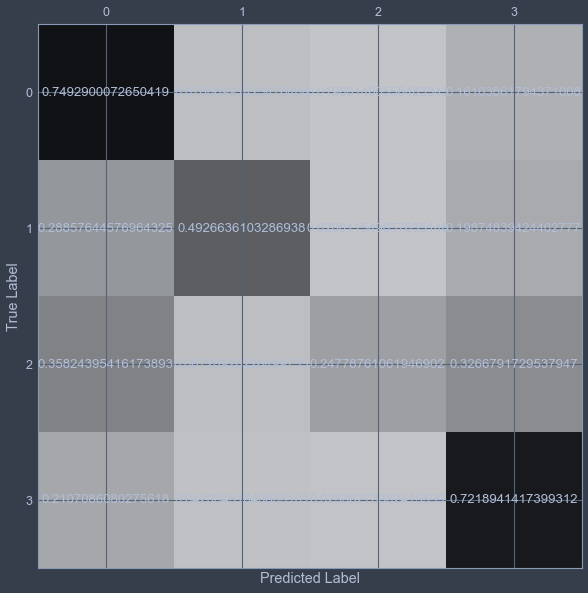

In [152]:
# Plot the Predicted Label vs. True Label accuracy matrix
cmn = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
fig,ax = plt.subplots(figsize=(10,10))
ax.matshow(cmn, cmap=plt.cm.Greys, alpha=0.7)
for i in range(cmn.shape[0]):
    for j in range(cmn.shape[1]):
        ax.text(x=j, y=i, s=cmn[i,j], va='center', ha='center')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

    Let's review the labels:
     * Label 0 = Natural Cause
     * Label 1 = Arson
     * Label 2 = Negligence
     * Label 3 = Infrastructure
 
* The model achieved a 74% accuracy when predicting natural causes.
* The model achieved a 49% accuracy when predicting arson.
* The model achieved a 24% accuracy when predicting negligence.
* The model achieved a 72% accuracy when predicting infrastructure.

The initial goal was to predict, with accuracy, causes of wildfires within the United States. This was achieved with an accuracy of 58%. Thereafter, reducing the number of labels into four categories improved the prediction score to 66% for the random forest algorithm. Unfortunately, the algorithm DID NOT perform well when trying to distinguish between 'arson' and 'negligence' causes. The algorithm DID perform relatively well, however, in distinguishing natural causes and infrastructural problems.

## Predicting Size of Wildfires

For this machine learning algorithm, I would like to try to predict the class fire sizes of wildfires in the United States. The purpose of this algorithm is to identify whether a fire, in it's early states, could grow into a larger fire resulting in resources being allocated properly to fight the fire. To accomplish this, I will need to predict the size of the fire using the variable 'FIRE_CLASS', which includes several string labels that identify how the fire began. I will then convert these labels into numerical items. Since I'll be using supervised learning, I need to create training and test datasets.

### Model Preparation

In [231]:
# Write a SQL query for an initial dataframe
mlsize_df = pd.read_sql_query('''
                            SELECT FIRE_YEAR, DISCOVERY_DATE, STAT_CAUSE_DESCR, 
                            CONT_DATE, FIRE_SIZE_CLASS, LATITUDE, LONGITUDE, STATE 
                            FROM Fires
                            ORDER BY FIRE_SIZE DESC''', engine)
mlsize_df.head()

2019-09-15 17:23:09,320 INFO sqlalchemy.engine.base.Engine 
                            SELECT FIRE_YEAR, DISCOVERY_DATE, STAT_CAUSE_DESCR, 
                            CONT_DATE, FIRE_SIZE_CLASS, LATITUDE, LONGITUDE, STATE 
                            FROM Fires
                            ORDER BY FIRE_SIZE DESC


INFO:sqlalchemy.engine.base.Engine:
                            SELECT FIRE_YEAR, DISCOVERY_DATE, STAT_CAUSE_DESCR, 
                            CONT_DATE, FIRE_SIZE_CLASS, LATITUDE, LONGITUDE, STATE 
                            FROM Fires
                            ORDER BY FIRE_SIZE DESC


2019-09-15 17:23:09,322 INFO sqlalchemy.engine.base.Engine ()


INFO:sqlalchemy.engine.base.Engine:()


,FIRE_YEAR,DISCOVERY_DATE,STAT_CAUSE_DESCR,CONT_DATE,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,STATE
0,1997,2450624.5,Lightning,2450700.5,G,61.982700,-157.085700,AK
1,2012,2456116.5,Lightning,2456138.5,G,42.391894,-117.893687,OR
2,2011,2455710.5,Campfire,2455754.5,G,33.606111,-109.449722,AZ
3,2004,2453169.5,Lightning,2453278.5,G,65.266300,-146.885800,AK
4,2009,2455003.5,Lightning,2455085.5,G,64.746700,-149.504700,AK


In [234]:
# FEAUTRE ENGINEERING: Create a new column that identifies the time it took for the fire to become contained
mlsize_df['CONT_TIME'] = mlsize_df['CONT_DATE'] - mlsize_df['DISCOVERY_DATE']

In [235]:
# Create a new datetime column for each DISCOVERY_DATE and CONT_DATE
mlsize_df['FIRE_DISC_DATE'] = pd.to_datetime(mlsize_df['DISCOVERY_DATE'] - pd.Timestamp(0).to_julian_date(), unit='D')
mlsize_df['FIRE_CONT_DATE'] = pd.to_datetime(mlsize_df['CONT_DATE'] - pd.Timestamp(0).to_julian_date(), unit='D')

In [236]:
# FEAUTRE ENGINEERING: Create a new column for discovery month
mlsize_df['DISC_MONTH'] = pd.DatetimeIndex(mlsize_df['FIRE_DISC_DATE']).month

In [237]:
# FEAUTRE ENGINEERING: Create a new column for discovery day of week
mlsize_df['DISC_DAY_OF_WEEK'] = mlsize_df['FIRE_DISC_DATE'].dt.weekday_name

In [238]:
mlsize_df.head()

,FIRE_YEAR,DISCOVERY_DATE,STAT_CAUSE_DESCR,CONT_DATE,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,STATE,CONT_TIME,FIRE_DISC_DATE,FIRE_CONT_DATE,DISC_MONTH,DISC_DAY_OF_WEEK
0,1997,2450624.5,Lightning,2450700.5,G,61.982700,-157.085700,AK,76.0,1997-06-25,1997-09-09,6,Wednesday
1,2012,2456116.5,Lightning,2456138.5,G,42.391894,-117.893687,OR,22.0,2012-07-08,2012-07-30,7,Sunday
2,2011,2455710.5,Campfire,2455754.5,G,33.606111,-109.449722,AZ,44.0,2011-05-29,2011-07-12,5,Sunday
3,2004,2453169.5,Lightning,2453278.5,G,65.266300,-146.885800,AK,109.0,2004-06-13,2004-09-30,6,Sunday
4,2009,2455003.5,Lightning,2455085.5,G,64.746700,-149.504700,AK,82.0,2009-06-21,2009-09-11,6,Sunday


In [239]:
# Drop the FIRE_DISC_DATE, FIRE_CONT_DATE, and CONT_DATE columns
mlsize_df = mlsize_df.drop('CONT_DATE', axis=1)
mlsize_df = mlsize_df.drop('FIRE_DISC_DATE', axis=1)
mlsize_df = mlsize_df.drop('FIRE_CONT_DATE', axis=1)

In [240]:
# FEAUTRE ENGINEERING: Label encode the columns for numerical calculations
le = preprocessing.LabelEncoder()
mlsize_df['STAT_CAUSE_DESCR'] = le.fit_transform(mlsize_df['STAT_CAUSE_DESCR'])
mlsize_df['STATE'] = le.fit_transform(mlsize_df['STATE'])
mlsize_df['DISC_DAY_OF_WEEK'] = le.fit_transform(mlsize_df['DISC_DAY_OF_WEEK'])
mlsize_df['DISC_MONTH'] = le.fit_transform(mlsize_df['DISC_MONTH'])
mlsize_df['FIRE_SIZE_CLASS'] = le.fit_transform(mlsize_df['FIRE_SIZE_CLASS'])

In [241]:
mlsize_df.head()

,FIRE_YEAR,DISCOVERY_DATE,STAT_CAUSE_DESCR,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,STATE,CONT_TIME,DISC_MONTH,DISC_DAY_OF_WEEK
0,1997,2450624.5,6,6,61.982700,-157.085700,0,76.0,5,6
1,2012,2456116.5,6,6,42.391894,-117.893687,37,22.0,6,3
2,2011,2455710.5,1,6,33.606111,-109.449722,3,44.0,4,3
3,2004,2453169.5,6,6,65.266300,-146.885800,0,109.0,5,3
4,2009,2455003.5,6,6,64.746700,-149.504700,0,82.0,5,3


In [242]:
# Replace the null values with a '1'
# These null values are a result of the containment day being the same as discovery day 
# (fires that began and ended in the same day)
mlsize_df.CONT_TIME = mlsize_df.CONT_TIME.fillna(value=1.0)

In [243]:
# Create new dataframes with and without 'FIRE_SIZE_CLASS'
X = mlsize_df.drop(['FIRE_SIZE_CLASS'], axis=1).values
y = mlsize_df['FIRE_SIZE_CLASS'].values

In [244]:
# Perform a train/test split on the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0) #30% for testing, 70% for training

### Default Random Forest

In [245]:
# Initialize RandomForestClassifier from SkLearn
rfc_model = RandomForestClassifier(n_estimators=50)

In [246]:
# Fit the model on the X_train and y_train data
rfc_model.fit(X_train,y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=50, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [247]:
# Print the model score based upon the random forest classifier
print(rfc_model.score(X_test,y_test))

0.6400928847449214


When training the model on the selected features, we achieved an 64% accuracy score. This a respectable score to correctly identify the class size of fires when we pass in future data. 

### Improved Random Forest

When beginning this project, I mentioned living in California and experiencing some of the largest wildfires in United States history. These fires were note included in the dataset (2017, 2018), nonetheless, it's known California is home to the largest numbers of wildfires. This can be visualized in the first bar graph in this project. To shrink the dataset with the aim of accurately predicting the class size of wildfires within one state, let's use rows within the dataframe where STATE = 4 (numerical label for CA). 

In [248]:
# FEAUTURE ENGINEERING: Drop all rows where STATE != 4
# Drop CONT_TIME
mlsize_df = mlsize_df.loc[mlsize_df['STATE'] == 4]
mlsize_df = mlsize_df.drop('CONT_TIME', axis = 1)
mlsize_df.head()

,FIRE_YEAR,DISCOVERY_DATE,STAT_CAUSE_DESCR,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,STATE,DISC_MONTH,DISC_DAY_OF_WEEK
19,2012,2456151.5,6,6,40.615300,-120.115300,4,7,3
29,2003,2452937.5,1,6,32.985556,-116.727500,4,9,2
36,2013,2456521.5,7,6,37.860556,-120.083056,4,7,2
43,2007,2454285.5,4,6,34.779167,-120.090000,4,6,6
66,2007,2454394.5,7,6,33.074444,-116.711111,4,9,3


In [249]:
# Create new dataframes with and without 'FIRE_SIZE_CLASS'
X = mlsize_df.drop(['FIRE_SIZE_CLASS'], axis=1).values
y = mlsize_df['FIRE_SIZE_CLASS'].values

In [250]:
# Perform a train/test split on the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0) #30% for testing, 70% for training

In [251]:
# Initialize RandomForestClassifier from SkLearn
rfc_model = RandomForestClassifier(n_estimators=50)

In [252]:
# Fit the model on the X_train and y_train data
rfc_model.fit(X_train,y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=50, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [253]:
# Print the model score based upon the random forest classifier
print(rfc_model.score(X_test,y_test))

0.6026905829596413


It doesn't seem that targeting one state has improved the score of the model. Here we achieved a score of 60%. One devastating characteristic of wildfires in California are larger fires which can spread very quickly to urban areas. It could be important to build an algorithm that could be used in the early stages of a fire to predict, given the location, could grow into a dangerous fire. I will continue to use the state, but will create a binary label of fires less or greater than 1,000 acres. 

In [261]:
# Write a function to set labels where 0 = small fire, 1 = large fire
def set_label(siz):
    sizes = 0
    small = [1, 2, 3, 4]
    large = [5, 6]
    if siz in small:
        size = 0
    else:
        size = 1
    return size

In [262]:
mlsize_df['FIRE_SIZE_LABEL'] = mlsize_df['FIRE_SIZE_CLASS'].apply(lambda x: set_label(x)) # I created a copy of the original df earlier in the kernel
mlsize_df.head()

,FIRE_YEAR,DISCOVERY_DATE,STAT_CAUSE_DESCR,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,STATE,DISC_MONTH,DISC_DAY_OF_WEEK,FIRE_SIZE_LABEL
19,2012,2456151.5,6,6,40.615300,-120.115300,4,7,3,2
29,2003,2452937.5,1,6,32.985556,-116.727500,4,9,2,2
36,2013,2456521.5,7,6,37.860556,-120.083056,4,7,2,2
43,2007,2454285.5,4,6,34.779167,-120.090000,4,6,6,2
66,2007,2454394.5,7,6,33.074444,-116.711111,4,9,3,2


In [263]:
# Count the values in FIRE_SIZE_LABEL column
mlsize_df.FIRE_SIZE_LABEL.value_counts()

2    99459
1    90091
Name: FIRE_SIZE_LABEL, dtype: int64

In [264]:
# Drop FIRE_SIZE_CLASS column
mlsize_df = mlsize_df.drop('FIRE_SIZE_CLASS', axis=1)

In [266]:
# Create new dataframes with and without 'FIRE_SIZE_CLASS'
X = mlsize_df.drop(['FIRE_SIZE_LABEL'], axis=1).values
y = mlsize_df['FIRE_SIZE_LABEL'].values

In [267]:
# Perform a train/test split on the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0) #30% for testing, 70% for training

In [268]:
# Initialize RandomForestClassifier from SkLearn
rfc_model = RandomForestClassifier(n_estimators=50)

In [269]:
# Fit the model on the X_train and y_train data
rfc_model.fit(X_train,y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=50, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [270]:
# Print the model score based upon the random forest classifier
print(rfc_model.score(X_test,y_test))

0.6543919810076497


In [271]:
# Display the confusion matrix
y_pred = rfc_model2.fit(X_train, y_train).predict(X_test)
cm = confusion_matrix(y_true = y_test, y_pred = y_pred)
print(cm)

[[17153  9668]
 [ 9911 20133]]


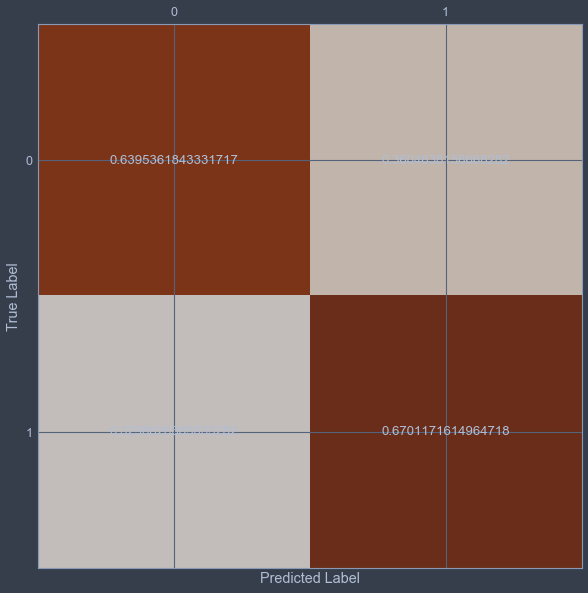

In [273]:
# Plot the Predicted Label vs. True Label accuracy matrix
cmn = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
fig,ax = plt.subplots(figsize=(10,10))
ax.matshow(cmn, cmap=plt.cm.Oranges, alpha=0.7)
for i in range(cmn.shape[0]):
    for j in range(cmn.shape[1]):
        ax.text(x=j, y=i, s=cmn[i,j], va='center', ha='center')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

* **Label 0** = Small Wildfire (0 - 1,000 acres)
* **Label 1** = Large Wildfire (1,000 - infinite acres)

The score we achieved for predicting a small vs. large wildfire in the state of California was 65%. Therefore we have only a 15% greater chance than a standard coin flip. Wildfires are difficult to gauge because of various environmental conditions and specific whether patterns in various areas of the country as well as timing during the course of the year. According to the confusion matrix, we were accurately able to predict the presence of a large wildfire 67% of the time and a small wildfire 64% of the time. 

# **Conclusion**

The aim of this project was to explore and predict the future of wildfires in the United States. Within this project contained a database of wildfires that occurred in the United States from 1992 to 2015. The data was originally generated by the national Fire Program Analysis (FPA) system. The wildfire records were acquired from the reporting systems of federal, state, and local fire organizations.


This project conveyed a major focus on visual explorations of the dataset. These visuals investigated the distribution of data and demonstrate the impact of wildfires across the country. There were surprising insights gained from building contour and animated basemaps as well as valuable recommendation points from seaborn bar plots. Wildfires were analyzed on days of the week, month of the year, average fire size per location, and many more characteristics.


To predict future wildfires, the project required supervised learning algorithms that used labeled data to create a machine learning model. Specifically, I used an ensemble method called  a random forest which utilizes a large number of individual decision trees that operate as an ensemble to classify specific predictors. Items that were modeled in this project were the causes of wildfires, based upon natural vs. human interactions, as well as predicting the sizes of potential wildfires given data in early stages of fires. 


## Points of Interest

•	In number of wildfires, California is leads the nation with almost 200,000 wildfires reported.


•	Looking at the top 10 most fire prone states, 6/10 are from southeastern states.


•	Many wildfire occurrences are found outskirts of Los Angeles and New York City. After looking into the instances, specifically in eastern New York, I found that many of these wildfires burn less than 10 acres, but occur frequently. There are a less than 100 instances in the state of New York that have burned more than 100 acres.


•	 Southeastern wildfires burn in the mid-late spring when burning conditions are at their peak.


•	The worst year for wildfires, in terms of the number of fires reported, was 2006.


•	In the beginning of the year 2006, wildfires are concentrated in the north and southeastern regions of the United States. The states of Oklahoma, Alabama, and New York seem to have concentrated wildfires within their respective state. 


•	As we move forward in the year 2006, the magnitude and quantity of wildfires shift towards the west. In the middle of the year, the southwestern states of Utah, Nevada, and Arizona share the brunt of the wildfires. Then around day 220 (early august) the wildfires become much more prevalent in the northwestern states. Idaho and Montana experience severe wildfires towards the end of the year.


•	In analyzing which fire unit reports to each fire, we can see that the Georgia Forestry Commission is dispatched the most often, almost 100,000 times since 1992-2015.


•	The next closest reporting unit is the Fire Department of New York, the South Carolina Forestry Commission and the Mississippi Forestry Commission. Surprisingly, the eastern and southeastern wildfire departments are dispatched much more often than the western departments.


•	The New Mexico State Forestry department has been dispatched almost 80 times to fight fires larger than 5,000 acres, the most in the country. Texas and Florida Forest service are next on the list with between 50 and 35 dispatches, respectively.


•	 When looking into the causes of fires within the data, it seems that debris burning outnumbers other causes my a sizable margin. Arson comes in second and its an unfortunate cause of wildfires within the United States. Lightning strikes, an unavoidable cause of fires, takes third.


•	Lightning strikes seem to be, by far and away, the largest contributor to fire size. I would estimate that because lightning strikes occur in randomized areas, it's likely that these strikes occur in very rural areas where 1) Forestry is likely to be dense and 2) It's difficult to contain wildfires in dense forestry/grassland and unpopulated areas.


•	Most fires are started on the weekends, with Saturday and Sunday being the top two days of the week when fires are reported. 


•	Late spring through summer are the months in which most of fires occur throughout the year. 


•	Class 'B' fires are the most prevalent fires in the U.S. these fires are considered to burn 0.26-9.9 acres of land. So when imagining the severity of class B fires, they do not appear to cause intensive damage to surrounding land or urban areas. 


•	Alaska houses the largest average size of fire by state. The average fire totals over 3,500 acres. This is likely contributed to the rural nature of the state, where lightning strikes could cause fires to burn for miles without any chance of containment.


•	In Hawaii, the average fire burns for almost 250 acres. Fires are uncommon in Hawaii, but when they occur, they burn for much longer than typical continental U.S. states.


•	In the continental U.S., Nevada leads the largest average fire with over 500 acres burned.


•	The non-continental states (AK and HI) surprise with the largest average fire containment time per state. The fires in these two states burn around 11-12 days.


•	Within continental states, Washington, Idaho, and New Jersey take the most time to contain fires. It seems as if these could use improvement in containing fires, possibly a point of emphasis for fire departments within each state.


•	2004 and 2005 contain the largest average fire size per year.


•	Containment time (CONT_TIME) has a slight correlation with latitude, and also fire size.

## Recommendations

To reiterate the usefulness of this project, fire departments, along with respective agencies could use the resulting models to predict future wild fire causes and sizes in the United States. The following recommendations would be used by fire reporting units and agencies to allocate resources appropriately to fight future fires. As our climate continues to change, wildfire data collection and prediction will become ever so important in keeping the public safe and retaining as much forestry as humanely possible.

**List of Recommendations**: 


* *Replace Faulty Powerlines*: Second only to the natural causes of lightning strikes, faulty powerlines have resulted in the second largest average size of fires (in acres). Although these powerlines, in frequency, are at the bottom of the list when analyzing total causes of fires, they are causing some of the largest. This result could be due to many rural powerlines causing fires that cannot be contained in a quick manner. Adding real-time monitoring techniques to powerlines could save thousands of acres of land as well as resources to fight these fires. 


* *Allocate Monthly Resources*: In the beginning of the year, wildfires are concentrated in the north and southeastern regions of the United States. The states of Georgia, South Carolina, and New York seem to have concentrated wildfires within their respective state. As we move forward in the year, the magnitude and quantity of wildfires shift towards the west. In the middle of the year, the southwestern states of Utah, Nevada, and Arizona share the brunt of the wildfires. Then around day 220 (early august) the wildfires become much more prevalent in the northwestern states. Idaho and Montana experience severe wildfires towards the end of the year. If aiding firefighters are dispatched across the country, it could be useful to know that southeastern states need resources in the spring, southwestern states in the summer, and northwestern states in the fall. 


* *Help Southwestern Reporting Units*: The New Mexico State Forestry department has been dispatched almost 80 times to fight fires larger than 5,000 acres. These fires are reported with a class 'G' rating. This number doubles almost any other deparment in the country. The Texas Forest service are next on the list with 50 dispatches. Oklahoma and Arizona are also in the top 5 most dispatched units to fight class 'G' fires. It seems the southwest/west has been dispatched more often to fight larger fires.


* *Decrease Fire Containment Time in Non-Continental States*: Alaska and Hawaii. These states are home to the two largest burn-times within the United States. Alaska houses the largest average size of fire by state. The average fire totals over 3,500 acres. This is likely contributed to the rural nature of the state, where lightning strikes could cause fires to burn for miles without any chance of containment. In Hawaii, the average fire burns for almost 250 acres. Fires are uncommon in Hawaii, but when they occur, they burn for much longer than typical continental U.S. states. 


## Further Work

If given more time and data, I would like to have known characteristics about fire fighting resources, such as human or equipment resources needed to fight these fires. Then I could built a model that could predict the resources needed to fight specific fires in different locations around the country. It would also be useful to analyze data based upon fire damage. If there was data collected on certain points such as monetary loses or property loses, it would be beneficial to identify if people living in a certain area should buy fire insurance.